In [1]:
import numpy as np
from pydub import AudioSegment
import random
import sys
import io
import os
import glob
import IPython
from td_utils import *
import gc
%matplotlib inline

/root/.virtualenvs/gpu-py3/lib/python3.5/site-packages/pydub/utils.py:165: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


In [2]:
Tx = 5511 # The number of time steps input to the model from the spectrogram
n_freq = 101 # Number of frequencies input to the model at each time step of the spectrogram
Ty = 1375 # The number of time steps in the output of our model

In [3]:
activates, negatives, backgrounds = load_raw_audio_thalon_list()
print(len(activates), len(negatives), len(backgrounds))
# 190 7058 496

190 7058 496


In [4]:
# print(activates)
print(activates[0])
print(negatives[0])
print(backgrounds[0])

./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_100.wav
./database/wav_resampling/general_lt_1sec/common_voice_es_18378519.wav
./database/my_database/background_mono_10sec/output_77_3.wav


In [5]:
def get_random_time_segment(segment_ms):
    """
    Gets a random time segment of duration segment_ms in a 10,000 ms audio clip.
    
    Arguments:
    segment_ms -- the duration of the audio clip in ms ("ms" stands for "milliseconds")
    
    Returns:
    segment_time -- a tuple of (segment_start, segment_end) in ms
    """
    
    segment_start = np.random.randint(low=0, high=10000-segment_ms)   # Make sure segment doesn't run past the 10sec background 
    segment_end = segment_start + segment_ms - 1
    
    return (segment_start, segment_end)

In [6]:
# GRADED FUNCTION: is_overlapping

def is_overlapping(segment_time, previous_segments):
    """
    Checks if the time of a segment overlaps with the times of existing segments.
    
    Arguments:
    segment_time -- a tuple of (segment_start, segment_end) for the new segment
    previous_segments -- a list of tuples of (segment_start, segment_end) for the existing segments
    
    Returns:
    True if the time segment overlaps with any of the existing segments, False otherwise
    """
    
    segment_start, segment_end = segment_time
    
    ### START CODE HERE ### (≈ 4 line)
    # Step 1: Initialize overlap as a "False" flag. (≈ 1 line)
    overlap = False
    
    # Step 2: loop over the previous_segments start and end times.
    # Compare start/end times and set the flag to True if there is an overlap (≈ 3 lines)
    for previous_start, previous_end in previous_segments:
        if segment_start <= previous_end and segment_end >= previous_start:
            overlap = True
    ### END CODE HERE ###

    return overlap

In [7]:
# GRADED FUNCTION: insert_audio_clip

def insert_audio_clip(background, audio_clip, previous_segments):
    """
    Insert a new audio segment over the background noise at a random time step, ensuring that the 
    audio segment does not overlap with existing segments.
    
    Arguments:
    background -- a 10 second background audio recording.  
    audio_clip -- the audio clip to be inserted/overlaid. 
    previous_segments -- times where audio segments have already been placed
    
    Returns:
    new_background -- the updated background audio
    """
    
    # Get the duration of the audio clip in ms
    segment_ms = len(audio_clip)
    
    # print('previous_segments #1:', previous_segments)
    
    ### START CODE HERE ### 
    # Step 1: Use one of the helper functions to pick a random time segment onto which to insert 
    # the new audio clip. (≈ 1 line)
    segment_time = get_random_time_segment(segment_ms)
    
    # Step 2: Check if the new segment_time overlaps with one of the previous_segments. If so, keep 
    # picking new segment_time at random until it doesn't overlap. (≈ 2 lines)
    while is_overlapping(segment_time, previous_segments):
        segment_time = get_random_time_segment(segment_ms)
        # print('overlapping, try again')

    # Step 3: Add the new segment_time to the list of previous_segments (≈ 1 line)
    previous_segments.append(segment_time)
    ### END CODE HERE ###
    
    # Step 4: Superpose audio segment and background
    new_background = background.overlay(audio_clip, position = segment_time[0])
    
    return new_background, segment_time

In [8]:
# GRADED FUNCTION: insert_ones

def insert_ones(y, segment_end_ms):
    """
    Update the label vector y. The labels of the 50 output steps strictly after the end of the segment 
    should be set to 1. By strictly we mean that the label of segment_end_y should be 0 while, the
    50 followinf labels should be ones.
    
    
    Arguments:
    y -- numpy array of shape (1, Ty), the labels of the training example
    segment_end_ms -- the end time of the segment in ms
    
    Returns:
    y -- updated labels
    """
    
    # duration of the background (in terms of spectrogram time-steps)
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
    
    # Add 1 to the correct index in the background label (y)
    ### START CODE HERE ### (≈ 3 lines)
    for i in range(segment_end_y + 1, segment_end_y + 51):
        if i < Ty:
            y[0, i] = 1
    ### END CODE HERE ###
    
    return y

In [9]:
# GRADED FUNCTION: create_training_example
tmp_filename = "./raw_thalon_audios_generator/tmp_data.wav"

def create_training_example(backgrounds, activates, negatives):
    """
    Creates a training example with a given background, activates, and negatives.
    
    Arguments:
    background -- a 10 second background audio recording
    activates -- a list of audio segments of the word "activate"
    negatives -- a list of audio segments of random words that are not "activate"
    
    Returns:
    x -- the spectrogram of the training example
    y -- the label at each time step of the spectrogram
    """
    
    # Select 0-4 random "activate" audio clips from the entire list of "activates" recordings
    random_activates = load_raw_data(random.sample(activates, k=random.randint(2, 4)))
    # print('random_activates', len(random_activates))
    
    # Select 0-2 random negatives audio recordings from the entire list of "negatives" recordings
    random_negatives = load_raw_data(random.sample(negatives, k=random.randint(1, 2)))
    # print('random_negatives', len(random_negatives))
    
    background = load_raw_data(random.sample(backgrounds, k=1))
    # print('background', len(background))
    
    # Make background quieter
    background = background[0]# - 20

    ### START CODE HERE ###
    # Step 1: Initialize y (label vector) of zeros (≈ 1 line)
    y = np.zeros((1, Ty))

    # Step 2: Initialize segment times as empty list (≈ 1 line)
    previous_segments = []
    ### END CODE HERE ###
    
    
    ### START CODE HERE ### (≈ 3 lines)
    # Step 3: Loop over randomly selected "activate" clips and insert in background
    for random_activate in random_activates:
        # Insert the audio clip on the background
        background, segment_time = insert_audio_clip(background, random_activate, previous_segments)
        # Retrieve segment_start and segment_end from segment_time
        segment_start, segment_end = segment_time
        # Insert labels in "y"
        y = insert_ones(y, segment_end_ms=segment_end)
    ### END CODE HERE ###
    
    # print('previous_segments_active:', previous_segments)    

    ### START CODE HERE ### (≈ 2 lines)
    # Step 4: Loop over randomly selected negative clips and insert in background
    for random_negative in random_negatives:
        # Insert the audio clip on the background 
        background, _ = insert_audio_clip(background, random_negative, previous_segments)
    ### END CODE HERE ###
    
    # Standardize the volume of the audio clip 
    background = match_target_amplitude(background, -20.0)
    
    # print('previous_segments_total:', previous_segments)

    # Export new training example 
    # file_handle = background.export("./raw_thalon_audios/train_" + str(counter) + ".wav", format="wav")
    file_handle = background.export(tmp_filename, format="wav")
    # print("File (train_" + str(counter) + ".wav) was saved in your directory.")
    
    # Get and plot spectrogram of the new recording (background with superposition of positive and negatives)
    x = graph_spectrogram(tmp_filename)#"./raw_thalon_audios/train_" + str(counter) + ".wav")
    
    return x, y

In [10]:
def generate_train_batch(backgrounds, activates, negatives, batch_size):
    while True:
        X_data = []
        Y_data = []
        x = 0
        y = 0
        for index in range(batch_size):
            x, y = create_training_example(backgrounds, activates, negatives)
            X_data.append(x.transpose())
            Y_data.append(y.transpose())
            gc.collect()
        # print(len(X_data))
        yield (np.asarray(X_data), np.asarray(Y_data))

train_gen = generate_train_batch(backgrounds, activates, negatives, batch_size = 16)

(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)
(2, 5511, 101) (2, 1375, 1)


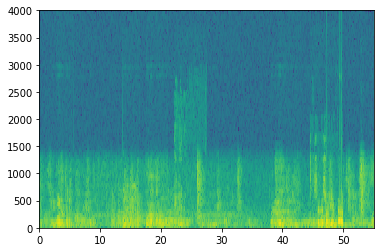

In [11]:
for index, item in enumerate(generate_train_batch(backgrounds, activates, negatives, batch_size = 2)):
    X, Y = item    
    print(X.shape, Y.shape)
    # plt.plot(Y[0])
    if index == 10:
        break

In [ ]:
# X_data = []
# Y_data = []
# num_data = 4000

# # cnt_data = 0
# # while True:
# for cnt_data in range(1, num_data + 1):
#     # print('Creating {0} of {1}. Progress: {2}'.format(cnt_data, num_data, cnt_data/float(num_data)))
#     x, y = create_training_example(backgrounds, activates, negatives)
#     X_data.append(x.transpose())
#     Y_data.append(y.transpose())
    
#     if cnt_data == num_data:
#         np.save('./XY_thalon_train/X_thalon.npy', X_data)
#         np.save('./XY_thalon_train/Y_thalon.npy', Y_data)
#         print('************************* Saving data at {} iteration **********************'.format(cnt_data))
#     '''
#     if cnt_data % 1000 == 0:
#         x = input('Enter your input (x to exit):')
#         if x == 'x':
#             break
    
#     cnt_data += 1
#     '''

Creating 1 of 4000. Progress: 0.00025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_141.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751335.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_58_0.wav
background 1
previous_segments_active: [(1821, 2514)]
previous_segments_total: [(1821, 2514), (4316, 5315)]
File (train_1.wav) was saved in your directory.
Creating 2 of 4000. Progress: 0.0005
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_39.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18440747.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354611.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_9_3.wav
background 1
previous_segments_active: [(2769, 3611)]
previous_segments_total: [(2769, 3611), (4149, 5148), (836, 1835)]
File (train_2.wav) was saved in your directory.
Creating 3 

Creating 17 of 4000. Progress: 0.00425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_148.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18690494.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_42_st_mono_2.wav
background 1
previous_segments_active: [(7385, 8155)]
previous_segments_total: [(7385, 8155), (5355, 6354)]
File (train_17.wav) was saved in your directory.
Creating 18 of 4000. Progress: 0.0045
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_181.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_37.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_119.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726195.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354574.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_64_1.wav
background 1
previous_segmen

background 1
previous_segments_active: [(3106, 3838), (6746, 7456), (7945, 8660), (5411, 6085)]
previous_segments_total: [(3106, 3838), (6746, 7456), (7945, 8660), (5411, 6085), (4119, 5118), (1830, 2829)]
File (train_29.wav) was saved in your directory.
Creating 30 of 4000. Progress: 0.0075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_100.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18809451.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_48_2.wav
background 1
previous_segments_active: [(7600, 8177)]
previous_segments_total: [(7600, 8177), (423, 1422)]
File (train_30.wav) was saved in your directory.
Creating 31 of 4000. Progress: 0.00775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345983.wav
opening ./database

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502676.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_38_st_mono_2.wav
background 1
previous_segments_active: [(2334, 2862), (7585, 8355)]
previous_segments_total: [(2334, 2862), (7585, 8355), (3920, 4919), (8724, 9723)]
File (train_44.wav) was saved in your directory.
Creating 45 of 4000. Progress: 0.01125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_169.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_7.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_157.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_50.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345940.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_32_1.wav
background 1
previous_segments_active: [(2755, 3476), (9205, 9894), (7041, 7684), (5317, 5846)]
previous_segments_total: [(2

Creating 58 of 4000. Progress: 0.0145
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_140.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_155.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18814688.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18415151.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_58_0.wav
background 1
previous_segments_active: [(7975, 8900), (5610, 6281)]
previous_segments_total: [(7975, 8900), (5610, 6281), (3479, 4478), (1227, 2226)]
File (train_58.wav) was saved in your directory.
Creating 59 of 4000. Progress: 0.01475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_79.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_181.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_155.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649547.wav
opening ./da

background 1
previous_segments_active: [(8364, 8928), (7725, 8300), (1929, 2519)]
previous_segments_total: [(8364, 8928), (7725, 8300), (1929, 2519), (2911, 3910)]
File (train_71.wav) was saved in your directory.
Creating 72 of 4000. Progress: 0.018
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_52.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_31.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695773.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18506308.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_23_st_mono_0.wav
background 1
previous_segments_active: [(2657, 3278), (4252, 4956)]
previous_segments_total: [(2657, 3278), (4252, 4956), (7517, 8516), (1425, 2424)]
File (train_72.wav) was saved in your directory.
Creating 73 of 4000. Progress: 0.01825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
random_activates 1
opening ./dat

Creating 86 of 4000. Progress: 0.0215
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_98.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756444.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_20_1.wav
background 1
previous_segments_active: [(43, 670)]
previous_segments_total: [(43, 670), (5767, 6766)]
File (train_86.wav) was saved in your directory.
Creating 87 of 4000. Progress: 0.02175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_29.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_103.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_92.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605841.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359452.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_43_2.wav
background 1
previous_segments_active: [(139

background 1
previous_segments_active: [(8002, 8723), (7128, 7767), (4023, 4494)]
previous_segments_total: [(8002, 8723), (7128, 7767), (4023, 4494), (4947, 5946), (987, 1986)]
File (train_99.wav) was saved in your directory.
Creating 100 of 4000. Progress: 0.025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_73.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_191.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18810184.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395174.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_59_3.wav
background 1
previous_segments_active: [(2619, 3719), (4974, 5756)]
previous_segments_total: [(2619, 3719), (4974, 5756), (7616, 8615), (8665, 9664)]
File (train_100.wav) was saved in your directory.
Creating 101 of 4000. Progress: 0.02525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_143.wav
opening ./thalon_audio

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_24_st_mono_2.wav
background 1
previous_segments_active: [(2143, 2765)]
previous_segments_total: [(2143, 2765), (5145, 6144)]
File (train_113.wav) was saved in your directory.
Creating 114 of 4000. Progress: 0.0285
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_180.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_196.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_170.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756560.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18331593.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_23_st_mono_1.wav
background 1
previous_segments_active: [(2805, 3380), (5728, 6496), (264, 985)]
previous_segments_total: [(2805, 3380), (5728, 6496), (264, 985), (8801, 9800), (4523, 5522)]
File (train_114.wav) was saved in your directory.


Creating 127 of 4000. Progress: 0.03175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_120.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_195.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816718.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371272.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_49_3.wav
background 1
previous_segments_active: [(219, 721), (7966, 8738)]
previous_segments_total: [(219, 721), (7966, 8738), (1285, 2284), (5968, 6967)]
File (train_127.wav) was saved in your directory.
Creating 128 of 4000. Progress: 0.032
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_169.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_29.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_32.wav
random_activates 4
opening ./database/wav_re

Creating 140 of 4000. Progress: 0.035
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_109.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_124.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_41.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18832146.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_20_st_mono_3.wav
background 1
previous_segments_active: [(3039, 3645), (4493, 5196), (1642, 2209)]
previous_segments_total: [(3039, 3645), (4493, 5196), (1642, 2209), (7902, 8901)]
File (train_140.wav) was saved in your directory.
Creating 141 of 4000. Progress: 0.03525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_104.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373125.wav
random_negatives 1
opening ./database/my_database/background_mono_10

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_15_3.wav
background 1
previous_segments_active: [(5021, 5777), (8976, 9768), (5908, 6545), (896, 1668)]
previous_segments_total: [(5021, 5777), (8976, 9768), (5908, 6545), (896, 1668), (3003, 4002), (7645, 8644)]
File (train_153.wav) was saved in your directory.
Creating 154 of 4000. Progress: 0.0385
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_100.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_101.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_169.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755944.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_30_st_mono_2.wav
background 1
previous_segments_active: [(2011, 2797), (5676, 6253), (4808, 5306), (484, 1205)]
previous_segments_total: [(2011, 2797), (5676, 625

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736671.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_36_3.wav
background 1
previous_segments_active: [(9453, 9953), (4510, 5184), (3762, 4477)]
previous_segments_total: [(9453, 9953), (4510, 5184), (3762, 4477), (590, 1589), (7984, 8983)]
File (train_167.wav) was saved in your directory.
Creating 168 of 4000. Progress: 0.042
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_107.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18833996.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_0.wav
background 1
previous_segments_active: [(9222, 9779), (8006, 8568)]
previous_segments_total: [(9222, 9779), (8006, 8568), (1198, 2197)]
File (train_168.wav) was saved in your directory.
Creating 169 of 4000. Progress: 0.04225
opening ./thalon

Creating 181 of 4000. Progress: 0.04525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_132.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_180.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751457.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_24_st_mono_2.wav
background 1
previous_segments_active: [(2445, 3226), (4136, 4711)]
previous_segments_total: [(2445, 3226), (4136, 4711), (5689, 6688)]
File (train_181.wav) was saved in your directory.
Creating 182 of 4000. Progress: 0.0455
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_140.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_182.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18525720.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18727969.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_51_0.

Creating 195 of 4000. Progress: 0.04875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_84.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_187.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590245.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18319381.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_4_3.wav
background 1
previous_segments_active: [(8729, 9435), (1497, 2157), (7203, 7887)]
previous_segments_total: [(8729, 9435), (1497, 2157), (7203, 7887), (4359, 5358), (2664, 3663)]
File (train_195.wav) was saved in your directory.
Creating 196 of 4000. Progress: 0.049
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_163.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_172.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice

previous_segments_total: [(2562, 3233), (4829, 5828)]
File (train_208.wav) was saved in your directory.
Creating 209 of 4000. Progress: 0.05225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_196.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_199.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_89.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855358.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_9_st_mono_1.wav
background 1
previous_segments_active: [(2920, 3688), (6208, 6970), (8558, 9119)]
previous_segments_total: [(2920, 3688), (6208, 6970), (8558, 9119), (4835, 5834)]
File (train_209.wav) was saved in your directory.
Creating 210 of 4000. Progress: 0.0525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_89.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_1

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18602872.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_74_3.wav
background 1
previous_segments_active: [(7469, 7962), (4552, 5023), (5508, 6111), (2321, 3082)]
previous_segments_total: [(7469, 7962), (4552, 5023), (5508, 6111), (2321, 3082), (3488, 4487), (788, 1787)]
File (train_221.wav) was saved in your directory.
Creating 222 of 4000. Progress: 0.0555
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_53.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_14.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18644003.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_27_2.wav
background 1
previous_segments_active: [(3156, 3682), (5711, 6416), (1109, 1769)]
previous_segments_total: [(3156, 3682), (5711, 6416), (1109, 17

Creating 235 of 4000. Progress: 0.05875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_99.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755704.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376299.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_3_st_mono_1.wav
background 1
previous_segments_active: [(5754, 6419)]
previous_segments_total: [(5754, 6419), (7544, 8543), (3422, 4421)]
File (train_235.wav) was saved in your directory.
Creating 236 of 4000. Progress: 0.059
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18499754.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18890509.wav
random_negatives 2
opening

File (train_247.wav) was saved in your directory.
Creating 248 of 4000. Progress: 0.062
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_117.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336369.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_8_1.wav
background 1
previous_segments_active: [(7123, 7618)]
previous_segments_total: [(7123, 7618), (1432, 2431)]
File (train_248.wav) was saved in your directory.
Creating 249 of 4000. Progress: 0.06225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_19.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_176.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736485.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_30_3.wav
background 1
previous_segments_active: [(6102, 6768), (4660, 5258)]
previous_segments_total: [(6102, 6768), (4660, 5258), (8300, 9299)

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18573304.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_3_3.wav
background 1
previous_segments_active: [(1355, 1966), (6697, 7363), (4992, 5753)]
previous_segments_total: [(1355, 1966), (6697, 7363), (4992, 5753), (7394, 8393), (2162, 3161)]
File (train_261.wav) was saved in your directory.
Creating 262 of 4000. Progress: 0.0655
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_136.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311104.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371069.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_15_1.wav
background 1
previous_segments_active: [(6461, 7455)]
previous_segments_total: [(6461, 7455), (2622, 3621), (8499, 9498)]
File (train_262.wav) was saved in your directory.
Creating 263 of 4000. Progress: 0.06575
opening ./thalon_aud

background 1
previous_segments_active: [(1135, 1645), (124, 830), (7708, 8550), (5138, 5769)]
previous_segments_total: [(1135, 1645), (124, 830), (7708, 8550), (5138, 5769), (2028, 3027)]
File (train_273.wav) was saved in your directory.
Creating 274 of 4000. Progress: 0.0685
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_107.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772987.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_38_st_mono_3.wav
background 1
previous_segments_active: [(3272, 3834)]
previous_segments_total: [(3272, 3834), (5560, 6559)]
File (train_274.wav) was saved in your directory.
Creating 275 of 4000. Progress: 0.06875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_182.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_58.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_95.wav
random_activates 3
opening ./database/wav_resampling/

background 1
previous_segments_active: [(5628, 6255), (2862, 3644)]
previous_segments_total: [(5628, 6255), (2862, 3644), (8789, 9788)]
File (train_287.wav) was saved in your directory.
Creating 288 of 4000. Progress: 0.072
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_170.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_84.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_188.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18528705.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572767.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_36_0.wav
background 1
previous_segments_active: [(4251, 4972), (463, 1169), (9250, 9963)]
previous_segments_total: [(4251, 4972), (463, 1169), (9250, 9963), (1892, 2891), (5712, 6711)]
File (train_288.wav) was saved in your directory.
Creating 289 of 4000. Progress: 0.07225
opening ./thalon_audios/hola_thalon/

background 1
previous_segments_active: [(3732, 4338), (8542, 9252)]
previous_segments_total: [(3732, 4338), (8542, 9252), (982, 1981)]
File (train_300.wav) was saved in your directory.
Creating 301 of 4000. Progress: 0.07525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_87.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756617.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_40_st_mono_3.wav
background 1
previous_segments_active: [(4682, 5306)]
previous_segments_total: [(4682, 5306), (2892, 3891)]
File (train_301.wav) was saved in your directory.
Creating 302 of 4000. Progress: 0.0755
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_31.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_192.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_118.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778745.wav
opening 

Creating 316 of 4000. Progress: 0.079
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_61.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18703478.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737261.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_18_st_mono_0.wav
background 1
previous_segments_active: [(583, 1331)]
previous_segments_total: [(583, 1331), (5295, 6294), (6515, 7514)]
File (train_316.wav) was saved in your directory.
Creating 317 of 4000. Progress: 0.07925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_189.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18337833.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_19_st_mono_0.wav
background 1
previous_segments_active: [(1383, 2115)]
previous_segments_total: [(1383, 2115), (4074, 5073)]
File (train_317.wav) was saved in your

File (train_330.wav) was saved in your directory.
Creating 331 of 4000. Progress: 0.08275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_154.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_79.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18348913.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790180.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_13_3.wav
background 1
previous_segments_active: [(8132, 8810), (963, 1606)]
previous_segments_total: [(8132, 8810), (963, 1606), (2006, 3005), (6273, 7272)]
File (train_331.wav) was saved in your directory.
Creating 332 of 4000. Progress: 0.083
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_90.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_100.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_43.wav
random_activates 3
opening ./database/wav_resampling/general_l

File (train_345.wav) was saved in your directory.
Creating 346 of 4000. Progress: 0.0865
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_109.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_147.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_128.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342231.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321763.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_1_st_mono_1.wav
background 1
previous_segments_active: [(805, 1411), (2521, 3200), (6650, 7291)]
previous_segments_total: [(805, 1411), (2521, 3200), (6650, 7291), (7806, 8805), (4559, 5558)]
File (train_346.wav) was saved in your directory.
Creating 347 of 4000. Progress: 0.08675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18531932.

File (train_362.wav) was saved in your directory.
Creating 363 of 4000. Progress: 0.09075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_188.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_141.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18370935.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311421.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_18_2.wav
background 1
previous_segments_active: [(2549, 3262), (7909, 8659), (591, 1284)]
previous_segments_total: [(2549, 3262), (7909, 8659), (591, 1284), (4027, 5026), (5464, 6463)]
File (train_363.wav) was saved in your directory.
Creating 364 of 4000. Progress: 0.091
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18356544.wav
openi

Creating 376 of 4000. Progress: 0.094
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_84.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_55.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18898240.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321782.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_25_3.wav
background 1
previous_segments_active: [(3147, 3853), (8179, 8672), (2165, 2701)]
previous_segments_total: [(3147, 3853), (8179, 8672), (2165, 2701), (7128, 8127), (3998, 4997)]
File (train_376.wav) was saved in your directory.
Creating 377 of 4000. Progress: 0.09425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_120.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_116.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_40.wav
random_activa

background 1
previous_segments_active: [(7865, 8544), (8688, 9309)]
previous_segments_total: [(7865, 8544), (8688, 9309), (3366, 4365), (5034, 6033)]
File (train_389.wav) was saved in your directory.
Creating 390 of 4000. Progress: 0.0975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_9.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18648378.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_24_st_mono_2.wav
background 1
previous_segments_active: [(1653, 2361), (6656, 7635), (3996, 4715)]
previous_segments_total: [(1653, 2361), (6656, 7635), (3996, 4715), (2970, 3969)]
File (train_390.wav) was saved in your directory.
Creating 391 of 4000. Progress: 0.09775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_9.wav
random_activates 1
opening ./database/w

Creating 405 of 4000. Progress: 0.10125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_92.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18385656.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_1_st_mono_0.wav
background 1
previous_segments_active: [(7664, 8301), (4653, 5124)]
previous_segments_total: [(7664, 8301), (4653, 5124), (2200, 3199)]
File (train_405.wav) was saved in your directory.
Creating 406 of 4000. Progress: 0.1015
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_149.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18825326.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18848886.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_22_3.wav

Creating 418 of 4000. Progress: 0.1045
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_168.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18888915.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_15_2.wav
background 1
previous_segments_active: [(1136, 1830)]
previous_segments_total: [(1136, 1830), (3934, 4933)]
File (train_418.wav) was saved in your directory.
Creating 419 of 4000. Progress: 0.10475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_175.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378152.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_29_st_mono_2.wav
background 1
previous_segments_active: [(2342, 2931), (5928, 6531), (378, 1143)]
previous_segments_total

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_20_0.wav
background 1
previous_segments_active: [(3044, 3591), (1067, 1764), (7591, 8359), (6542, 7083)]
previous_segments_total: [(3044, 3591), (1067, 1764), (7591, 8359), (6542, 7083), (3912, 4911), (5357, 6356)]
File (train_433.wav) was saved in your directory.
Creating 434 of 4000. Progress: 0.1085
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18703480.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772090.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_47_0.wav
background 1
previous_segments_active: [(3778, 4271), (6930, 7581)]
previous_segments_total: [(3778, 4271), (6930, 7581), (422, 1421), (5113, 6112)]
File (train_434.wav) was saved in your directory.
Creating 435 of

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773213.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_52_0.wav
background 1
previous_segments_active: [(1004, 1983)]
previous_segments_total: [(1004, 1983), (6888, 7887), (2778, 3777)]
File (train_447.wav) was saved in your directory.
Creating 448 of 4000. Progress: 0.112
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_23.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18473703.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_47_3.wav
background 1
previous_segments_active: [(6239, 6872)]
previous_segments_total: [(6239, 6872), (258, 1257)]
File (train_448.wav) was saved in your directory.
Creating 449 of 4000. Progress: 0.11225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_129.wav
random_activates 2
opening ./da

Creating 461 of 4000. Progress: 0.11525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_85.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_19.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_139.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_43.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18459615.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_38_1.wav
background 1
previous_segments_active: [(6472, 7152), (2802, 3468), (944, 1712), (5224, 5829)]
previous_segments_total: [(6472, 7152), (2802, 3468), (944, 1712), (5224, 5829), (8858, 9857)]
File (train_461.wav) was saved in your directory.
Creating 462 of 4000. Progress: 0.1155
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18370918.wav
opening ./database/wav_resampling/general_lt_1sec/c

Creating 475 of 4000. Progress: 0.11875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_13.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_82.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_122.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320910.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_36_1.wav
background 1
previous_segments_active: [(2665, 3315), (5903, 6621), (7944, 8986)]
previous_segments_total: [(2665, 3315), (5903, 6621), (7944, 8986), (4895, 5894)]
File (train_475.wav) was saved in your directory.
Creating 476 of 4000. Progress: 0.119
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_116.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_86.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_112.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_197.wav
random_activates 4
opening ./databa

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_11_3.wav
background 1
previous_segments_active: [(4612, 5411), (6882, 7487), (2156, 2780), (3794, 4397)]
previous_segments_total: [(4612, 5411), (6882, 7487), (2156, 2780), (3794, 4397), (8154, 9153), (606, 1605)]
File (train_489.wav) was saved in your directory.
Creating 490 of 4000. Progress: 0.1225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_45.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_34.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354357.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_33_2.wav
background 1
previous_segments_active: [(3592, 4143), (2062, 2785), (7224, 7798)]
previous_segments_total: [(3592, 4143), (2062, 2785), (7224, 7798), (4733, 5732)]
File (train_490.wav) was saved in your directory.
Creating 49

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_72_3.wav
background 1
previous_segments_active: [(7572, 8344), (737, 1396), (6656, 7485)]
previous_segments_total: [(7572, 8344), (737, 1396), (6656, 7485), (3419, 4418), (8710, 9709)]
File (train_502.wav) was saved in your directory.
Creating 503 of 4000. Progress: 0.12575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_99.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_144.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_129.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18384546.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18440747.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_2_st_mono_2.wav
background 1
previous_segments_active: [(2823, 3488), (4455, 5109), (623, 1164), (3720, 4315)]


Creating 515 of 4000. Progress: 0.12875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855842.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_58_2.wav
background 1
previous_segments_active: [(8010, 8729), (1422, 2027)]
previous_segments_total: [(8010, 8729), (1422, 2027), (4528, 5527)]
File (train_515.wav) was saved in your directory.
Creating 516 of 4000. Progress: 0.129
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_190.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_125.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18344776.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755701.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_71_3.wav
backgr

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629348.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_31_3.wav
background 1
previous_segments_active: [(14, 732)]
previous_segments_total: [(14, 732), (1535, 2534), (8180, 9179)]
File (train_528.wav) was saved in your directory.
Creating 529 of 4000. Progress: 0.13225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_7.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_81.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_47.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_200.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641440.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18566196.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_27_0.wav
background 1
previous_segments_active: [(7445, 8134), (1011, 1590), (8654, 9189), (208

background 1
previous_segments_active: [(3061, 3606), (5162, 5767)]
previous_segments_total: [(3061, 3606), (5162, 5767), (1108, 2107)]
File (train_542.wav) was saved in your directory.
Creating 543 of 4000. Progress: 0.13575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_98.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336260.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398855.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_72_1.wav
background 1
previous_segments_active: [(8949, 9576)]
previous_segments_total: [(8949, 9576), (787, 1786), (2768, 3767)]
File (train_543.wav) was saved in your directory.
Creating 544 of 4000. Progress: 0.136
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_149.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_1831141

Creating 557 of 4000. Progress: 0.13925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_169.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816776.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_9_0.wav
background 1
previous_segments_active: [(6734, 7455)]
previous_segments_total: [(6734, 7455), (7475, 8474)]
File (train_557.wav) was saved in your directory.
Creating 558 of 4000. Progress: 0.1395
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_140.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_66.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855247.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321423.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_37_0.wav
background 1
previous_segments_act

Creating 569 of 4000. Progress: 0.14225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_92.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_133.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_196.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_182.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18835946.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322427.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_35_3.wav
background 1
previous_segments_active: [(5667, 6304), (3154, 3760), (9229, 9997), (6455, 7045)]
previous_segments_total: [(5667, 6304), (3154, 3760), (9229, 9997), (6455, 7045), (254, 1253), (4653, 5652)]
File (train_569.wav) was saved in your directory.
Creating 570 of 4000. Progress: 0.1425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_56.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hol

File (train_580.wav) was saved in your directory.
Creating 581 of 4000. Progress: 0.14525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_132.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_112.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_101.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18514004.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_52_2.wav
background 1
previous_segments_active: [(8695, 9300), (5575, 6356), (2359, 2830), (3055, 3553)]
previous_segments_total: [(8695, 9300), (5575, 6356), (2359, 2830), (3055, 3553), (6977, 7976)]
File (train_581.wav) was saved in your directory.
Creating 582 of 4000. Progress: 0.1455
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav
random_activates 2
openin

Creating 596 of 4000. Progress: 0.149
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_129.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_172.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_84.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_154.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789691.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_66_3.wav
background 1
previous_segments_active: [(2509, 3050), (8685, 9215), (670, 1376), (7057, 7735)]
previous_segments_total: [(2509, 3050), (8685, 9215), (670, 1376), (7057, 7735), (4990, 5989)]
File (train_596.wav) was saved in your directory.
Creating 597 of 4000. Progress: 0.14925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_47.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18510942.wav
opening ./database/wav_resampling/general_lt_1sec/

Creating 611 of 4000. Progress: 0.15275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_181.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_20.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_132.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18652619.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424485.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_80_2.wav
background 1
previous_segments_active: [(4464, 5235), (212, 909), (6544, 7325)]
previous_segments_total: [(4464, 5235), (212, 909), (6544, 7325), (1779, 2778), (8050, 9049)]
File (train_611.wav) was saved in your directory.
Creating 612 of 4000. Progress: 0.153
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_30.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_1

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_2_st_mono_3.wav
background 1
previous_segments_active: [(5344, 5920)]
previous_segments_total: [(5344, 5920), (1197, 2196)]
File (train_624.wav) was saved in your directory.
Creating 625 of 4000. Progress: 0.15625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_70.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_155.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18837173.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_30_st_mono_2.wav
background 1
previous_segments_active: [(7292, 7790), (988, 1659)]
previous_segments_total: [(7292, 7790), (988, 1659), (7986, 8985)]
File (train_625.wav) was saved in your directory.
Creating 626 of 4000. Progress: 0.1565
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_136.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
opening ./th

Creating 638 of 4000. Progress: 0.1595
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_105.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765915.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_13_st_mono_0.wav
background 1
previous_segments_active: [(9044, 9572)]
previous_segments_total: [(9044, 9572), (944, 1943)]
File (train_638.wav) was saved in your directory.
Creating 639 of 4000. Progress: 0.15975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_94.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_124.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728373.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849202.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_24_st_mono_1.wav
background 1
previous_segments_active: [(3414, 3982), (5243, 5946)]
previous_segments_to

Creating 651 of 4000. Progress: 0.16275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_187.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18839980.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855493.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_15_st_mono_3.wav
background 1
previous_segments_active: [(6281, 6965)]
previous_segments_total: [(6281, 6965), (346, 1345), (3909, 4908)]
File (train_651.wav) was saved in your directory.
Creating 652 of 4000. Progress: 0.163
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_192.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_82.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354504.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18921985.wav
random_negatives 2
ope

Creating 664 of 4000. Progress: 0.166
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_161.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371115.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_3.wav
background 1
previous_segments_active: [(8820, 9433), (1503, 2195)]
previous_segments_total: [(8820, 9433), (1503, 2195), (2761, 3760)]
File (train_664.wav) was saved in your directory.
Creating 665 of 4000. Progress: 0.16625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_88.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_11.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_193.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18506298.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_52_2.wav
background 1
prev

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_15_st_mono_2.wav
background 1
previous_segments_active: [(1514, 2117), (3879, 4474), (2882, 3561)]
previous_segments_total: [(1514, 2117), (3879, 4474), (2882, 3561), (6716, 7715)]
File (train_679.wav) was saved in your directory.
Creating 680 of 4000. Progress: 0.17
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_109.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855440.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365438.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_78_1.wav
background 1
previous_segments_active: [(2525, 3131)]
previous_segments_total: [(2525, 3131), (7075, 8074), (3197, 4196)]
File (train_680.wav) was saved in your directory.
Creating 681 of 4000. Progress: 0.17025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_7.wav
opening ./thalon_audios/hola_thalon/V1

Creating 696 of 4000. Progress: 0.174
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_114.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641495.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18615205.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_15_1.wav
background 1
previous_segments_active: [(8223, 9202), (4800, 5493)]
previous_segments_total: [(8223, 9202), (4800, 5493), (5918, 6917), (62, 1061)]
File (train_696.wav) was saved in your directory.
Creating 697 of 4000. Progress: 0.17425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_47.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728412.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_40_2

Creating 709 of 4000. Progress: 0.17725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_61.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_127.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_132.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18608088.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320805.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_29_3.wav
background 1
previous_segments_active: [(9049, 9797), (322, 804), (4503, 5187), (7297, 8078)]
previous_segments_total: [(9049, 9797), (322, 804), (4503, 5187), (7297, 8078), (1667, 2666), (2721, 3720)]
File (train_709.wav) was saved in your directory.
Creating 710 of 4000. Progress: 0.1775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_195.wav
random_activates 1
opening ./database/wav_resampling/ge

Creating 721 of 4000. Progress: 0.18025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_87.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_147.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376297.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18703501.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_73_2.wav
background 1
previous_segments_active: [(8579, 9203), (6788, 7467)]
previous_segments_total: [(8579, 9203), (6788, 7467), (3834, 4833), (1574, 2573)]
File (train_721.wav) was saved in your directory.
Creating 722 of 4000. Progress: 0.1805
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_82.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641450.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_12_st_mono_1.wav
background 1
previous_segments_active: [(2742, 3460)]


Creating 735 of 4000. Progress: 0.18375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_191.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_179.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_169.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18883171.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18727977.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_12_3.wav
background 1
previous_segments_active: [(2199, 2981), (8469, 9149), (5189, 5910)]
previous_segments_total: [(2199, 2981), (8469, 9149), (5189, 5910), (434, 1433), (6405, 7404)]
File (train_735.wav) was saved in your directory.
Creating 736 of 4000. Progress: 0.184
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_178.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_54.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
random_activ

Creating 751 of 4000. Progress: 0.18775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_116.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_5.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_180.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_142.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424360.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312446.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_68_2.wav
background 1
previous_segments_active: [(3599, 4067), (2021, 2676), (5494, 6069), (7409, 8119)]
previous_segments_total: [(3599, 4067), (2021, 2676), (5494, 6069), (7409, 8119), (4314, 5313), (8417, 9416)]
File (train_751.wav) was saved in your directory.
Creating 752 of 4000. Progress: 0.188
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
random_activates 1
opening ./database/wav_resampling/g

Creating 766 of 4000. Progress: 0.1915
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_166.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18832127.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_63_3.wav
background 1
previous_segments_active: [(4960, 5681)]
previous_segments_total: [(4960, 5681), (1724, 2723)]
File (train_766.wav) was saved in your directory.
Creating 767 of 4000. Progress: 0.19175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18610413.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_71_2.wav
background 1
previous_segments_active: [(7971, 8721), (6221, 6805)]
previous_segments_total: [(7971, 8721), (6221, 6805), (2117, 3116)]
File (train_767.wav) was saved in your director

Creating 781 of 4000. Progress: 0.19525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_24.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18834123.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_74_3.wav
background 1
previous_segments_active: [(2779, 3367)]
previous_segments_total: [(2779, 3367), (1039, 2038)]
File (train_781.wav) was saved in your directory.
Creating 782 of 4000. Progress: 0.1955
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_110.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_191.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721856.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_15_2.wav
background 1
previous_segments_active: [(5422, 5893), (8130, 8912)]
previous_segments_total: [(5422, 5893), (8130, 8912), (1058, 2057)]
File (train_782.wav) was saved in your directo

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_84.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321711.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_67_2.wav
background 1
previous_segments_active: [(1037, 1813), (6714, 7420)]
previous_segments_total: [(1037, 1813), (6714, 7420), (5295, 6294)]
File (train_795.wav) was saved in your directory.
Creating 796 of 4000. Progress: 0.199
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_131.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_84.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18390550.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_24_1.wav
background 1
previous_segments_active: [(4991, 5533), (6661, 7179), (735, 1441)]
previous_segments_total: [(4991, 5533), (6661

Creating 808 of 4000. Progress: 0.202
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_127.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_113.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18689929.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_14_st_mono_2.wav
background 1
previous_segments_active: [(3854, 4496), (8582, 9064), (1433, 1951)]
previous_segments_total: [(3854, 4496), (8582, 9064), (1433, 1951), (2268, 3267)]
File (train_808.wav) was saved in your directory.
Creating 809 of 4000. Progress: 0.20225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_136.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_147.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18856745.wav
random_negatives 1
opening ./database/my_database/background_mono_1

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18892039.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_14_3.wav
background 1
previous_segments_active: [(9232, 9960), (6319, 6930)]
previous_segments_total: [(9232, 9960), (6319, 6930), (3937, 4936), (1904, 2903)]
File (train_821.wav) was saved in your directory.
Creating 822 of 4000. Progress: 0.2055
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_83.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_170.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18478936.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18898712.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_9_st_mono_2.wav
background 1
previous_segments_active: [(3183, 3852), (4942, 5663)]
previous_segments_total: [(3183, 3852), (4942, 5663), (1578, 2577), (6017, 7016)]
File (train_822.wav) was saved in

Creating 836 of 4000. Progress: 0.209
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_103.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_108.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18909415.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_59_0.wav
background 1
previous_segments_active: [(2469, 3091), (4659, 5159)]
previous_segments_total: [(2469, 3091), (4659, 5159), (1306, 2305)]
File (train_836.wav) was saved in your directory.
Creating 837 of 4000. Progress: 0.20925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_195.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721889.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755074.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_66_0.wav
background 1
previous_segments_active: [(2376, 3148)]
previous_segments_tot

Creating 853 of 4000. Progress: 0.21325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_137.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_165.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18657259.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18506298.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_42_0.wav
background 1
previous_segments_active: [(677, 1576), (2476, 3073), (6162, 6648)]
previous_segments_total: [(677, 1576), (2476, 3073), (6162, 6648), (4975, 5974), (7205, 8204)]
File (train_853.wav) was saved in your directory.
Creating 854 of 4000. Progress: 0.2135
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_70.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_178.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_89.wav
random_activ

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_15_st_mono_3.wav
background 1
previous_segments_active: [(8764, 9563), (2121, 3324), (6537, 7005), (765, 1267)]
previous_segments_total: [(8764, 9563), (2121, 3324), (6537, 7005), (765, 1267), (3352, 4351)]
File (train_865.wav) was saved in your directory.
Creating 866 of 4000. Progress: 0.2165
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_153.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_126.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18880315.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_17_st_mono_2.wav
background 1
previous_segments_active: [(5370, 5969), (1806, 2570)]
previous_segments_total: [(5370, 5969), (1806, 2570), (8783, 9782)]
File (train_866.wav) was saved in your directory.
Creating 867 of 4000. Progress: 0.21675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.

Creating 880 of 4000. Progress: 0.22
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_114.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_138.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18660178.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18626201.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_18_st_mono_3.wav
background 1
previous_segments_active: [(6084, 6777), (7612, 8515), (728, 1484)]
previous_segments_total: [(6084, 6777), (7612, 8515), (728, 1484), (2101, 3100), (3918, 4917)]
File (train_880.wav) was saved in your directory.
Creating 881 of 4000. Progress: 0.22025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_116.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18652625.wav
opening ./database/wav_resampling/general_lt_1s

Creating 896 of 4000. Progress: 0.224
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_24.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_73.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18898241.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18652648.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_6_st_mono_2.wav
background 1
previous_segments_active: [(5079, 5667), (7523, 8623)]
previous_segments_total: [(5079, 5667), (7523, 8623), (883, 1882), (2303, 3302)]
File (train_896.wav) was saved in your directory.
Creating 897 of 4000. Progress: 0.22425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_184.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_40.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_27.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18746414.wav
opening

Creating 910 of 4000. Progress: 0.2275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751161.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_21_3.wav
background 1
previous_segments_active: [(170, 926)]
previous_segments_total: [(170, 926), (8251, 9250)]
File (train_910.wav) was saved in your directory.
Creating 911 of 4000. Progress: 0.22775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_102.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_138.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18705859.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_3_st_mono_2.wav
background 1
previous_segments_active: [(7708, 8347), (4041, 4944)]
previous_segments_total: [(7708, 8347), (4041, 4944), (6193, 7192)]
File (train_911.wav) was saved in your dire

Creating 924 of 4000. Progress: 0.231
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_51.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_128.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321625.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18867017.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_13_st_mono_0.wav
background 1
previous_segments_active: [(4673, 5212), (3745, 4386)]
previous_segments_total: [(4673, 5212), (3745, 4386), (769, 1768), (1948, 2947)]
File (train_924.wav) was saved in your directory.
Creating 925 of 4000. Progress: 0.23125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_17.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_108.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18835808.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/ou

Creating 937 of 4000. Progress: 0.23425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_147.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18314921.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_51_1.wav
background 1
previous_segments_active: [(4658, 5337)]
previous_segments_total: [(4658, 5337), (6974, 7973)]
File (train_937.wav) was saved in your directory.
Creating 938 of 4000. Progress: 0.2345
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_144.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_102.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_57.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18895822.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_50_1.wav
background 1
previous_segments_active: [(8141, 8795), (5620, 6259), (6694, 7347)]
previous_segments_total: [(814

Creating 952 of 4000. Progress: 0.238
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_105.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_45.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_157.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18909740.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18667611.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_59_3.wav
background 1
previous_segments_active: [(518, 1046), (9168, 9719), (8178, 8821)]
previous_segments_total: [(518, 1046), (9168, 9719), (8178, 8821), (5086, 6085), (1598, 2597)]
File (train_952.wav) was saved in your directory.
Creating 953 of 4000. Progress: 0.23825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_197.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_125.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
opening ./th

Creating 967 of 4000. Progress: 0.24175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_70.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_192.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_35.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18610414.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_42_st_mono_0.wav
background 1
previous_segments_active: [(3577, 4075), (1736, 2416), (9202, 9965)]
previous_segments_total: [(3577, 4075), (1736, 2416), (9202, 9965), (5298, 6297)]
File (train_967.wav) was saved in your directory.
Creating 968 of 4000. Progress: 0.242
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_5.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_196.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_199.wav
random_activates 4
opening .

Creating 979 of 4000. Progress: 0.24475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_13.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_163.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18909782.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649349.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_32_st_mono_1.wav
background 1
previous_segments_active: [(8644, 9409), (4366, 5016), (1117, 1846), (2434, 3097)]
previous_segments_total: [(8644, 9409), (4366, 5016), (1117, 1846), (2434, 3097), (6430, 7429), (3247, 4246)]
File (train_979.wav) was saved in your directory.
Creating 980 of 4000. Progress: 0.245
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_87.wav
opening ./thalon_audios/hola_thalon/V1_todos_mo

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18800824.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_43_0.wav
background 1
previous_segments_active: [(5670, 6237), (2119, 2838)]
previous_segments_total: [(5670, 6237), (2119, 2838), (8611, 9610), (4535, 5534)]
File (train_994.wav) was saved in your directory.
Creating 995 of 4000. Progress: 0.24875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_24.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855370.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18493532.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_12_2.wav
background 1
previous_segments_active: [(7458, 8046)]
previous_segments_total: [(7458, 8046), (4954, 5953), (1944, 2943)]
File (train_995.wav) was saved in your directory.
Creating 996 of 4000. Progress: 0.249
opening ./thalon_audios/hola_thalon/V1_todos_mono

background 1
previous_segments_active: [(2637, 3370)]
previous_segments_total: [(2637, 3370), (4257, 5256), (6185, 7184)]
File (train_1008.wav) was saved in your directory.
Creating 1009 of 4000. Progress: 0.25225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_53.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_171.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18895837.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_st_mono_0.wav
background 1
previous_segments_active: [(7954, 8480), (8708, 9253)]
previous_segments_total: [(7954, 8480), (8708, 9253), (3822, 4821)]
File (train_1009.wav) was saved in your directory.
Creating 1010 of 4000. Progress: 0.2525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_143.wav
opening ./thalon_a

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778155.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_38_2.wav
background 1
previous_segments_active: [(1352, 2255), (3286, 3897), (7647, 8318)]
previous_segments_total: [(1352, 2255), (3286, 3897), (7647, 8318), (6615, 7614), (328, 1327)]
File (train_1021.wav) was saved in your directory.
Creating 1022 of 4000. Progress: 0.2555
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_45.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_51.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_105.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18523139.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_82_0.wav
background 1
previous_segments_active: [(355, 906), (3569, 4108), (6320, 6941), (4423, 4951)]
previous

Creating 1036 of 4000. Progress: 0.259
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_198.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_172.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_44.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_66.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605722.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18744964.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_20_3.wav
background 1
previous_segments_active: [(1885, 2696), (4219, 4749), (8463, 8952), (5386, 6409)]
previous_segments_total: [(1885, 2696), (4219, 4749), (8463, 8952), (5386, 6409), (7084, 8083), (338, 1337)]
File (train_1036.wav) was saved in your directory.
Creating 1037 of 4000. Progress: 0.25925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/h

Creating 1050 of 4000. Progress: 0.2625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_1.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_197.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_88.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18689894.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_39_st_mono_2.wav
background 1
previous_segments_active: [(4480, 5160), (8751, 9543), (5389, 6013)]
previous_segments_total: [(4480, 5160), (8751, 9543), (5389, 6013), (6448, 7447)]
File (train_1050.wav) was saved in your directory.
Creating 1051 of 4000. Progress: 0.26275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_185.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_122.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
random_activates 4
openi

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_st_mono_0.wav
background 1
previous_segments_active: [(4821, 5453)]
previous_segments_total: [(4821, 5453), (1943, 2942)]
File (train_1063.wav) was saved in your directory.
Creating 1064 of 4000. Progress: 0.266
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_182.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_31.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_32.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18504805.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790020.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_63_2.wav
background 1
previous_segments_active: [(2723, 3313), (486, 1190), (4948, 5546), (8348, 9147)]
previous_segments_total: [(2723, 3313), (486, 1190), (4948, 5546), (8

Creating 1077 of 4000. Progress: 0.26925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371166.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_42_0.wav
background 1
previous_segments_active: [(2397, 3031), (4618, 5383)]
previous_segments_total: [(2397, 3031), (4618, 5383), (7270, 8269)]
File (train_1077.wav) was saved in your directory.
Creating 1078 of 4000. Progress: 0.2695
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_110.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18474258.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_10_st_mono_2.wav
background 1
previous_segments_active: [(5710, 6496), (3893, 4364)]
previ

Creating 1091 of 4000. Progress: 0.27275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_192.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_112.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_110.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830325.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18346018.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_52_3.wav
background 1
previous_segments_active: [(3899, 4579), (9271, 9742), (166, 823), (7310, 7781)]
previous_segments_total: [(3899, 4579), (9271, 9742), (166, 823), (7310, 7781), (8246, 9245), (5389, 6388)]
File (train_1091.wav) was saved in your directory.
Creating 1092 of 4000. Progress: 0.273
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_176.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola

Creating 1105 of 4000. Progress: 0.27625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_193.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_126.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_180.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311220.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_19_1.wav
background 1
previous_segments_active: [(1472, 2260), (376, 1140), (2976, 3551), (7122, 7887)]
previous_segments_total: [(1472, 2260), (376, 1140), (2976, 3551), (7122, 7887), (5266, 6265)]
File (train_1105.wav) was saved in your directory.
Creating 1106 of 4000. Progress: 0.2765
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18473717.wav
random_negatives 1
opening ./database/my_datab

Creating 1120 of 4000. Progress: 0.28
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_8.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_108.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_120.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711822.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_6_3.wav
background 1
previous_segments_active: [(5546, 6205), (7679, 8179), (8338, 8840)]
previous_segments_total: [(5546, 6205), (7679, 8179), (8338, 8840), (414, 1413)]
File (train_1120.wav) was saved in your directory.
Creating 1121 of 4000. Progress: 0.28025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730508.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/outpu

Creating 1133 of 4000. Progress: 0.28325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_129.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771208.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376289.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_59_0.wav
background 1
previous_segments_active: [(1256, 1797)]
previous_segments_total: [(1256, 1797), (3662, 4661), (8592, 9591)]
File (train_1133.wav) was saved in your directory.
Creating 1134 of 4000. Progress: 0.2835
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_165.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_99.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_127.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736982.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726141.wav
random_negatives 2
openin

Creating 1148 of 4000. Progress: 0.287
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_117.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_96.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18532041.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_72_2.wav
background 1
previous_segments_active: [(9023, 9607), (8173, 8668), (3254, 3888)]
previous_segments_total: [(9023, 9607), (8173, 8668), (3254, 3888), (1937, 2936)]
File (train_1148.wav) was saved in your directory.
Creating 1149 of 4000. Progress: 0.28725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_32.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756872.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736483

Creating 1161 of 4000. Progress: 0.29025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_52.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_53.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354234.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_44_2.wav
background 1
previous_segments_active: [(8919, 9540), (7339, 7865)]
previous_segments_total: [(8919, 9540), (7339, 7865), (318, 1317)]
File (train_1161.wav) was saved in your directory.
Creating 1162 of 4000. Progress: 0.2905
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_19.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18566052.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18510944.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_61_2.wav
background 1
previous_segments_active: [(6134, 6800)]
previous_segments_tot

Creating 1175 of 4000. Progress: 0.29375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_56.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_58.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_132.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_122.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664430.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_2.wav
background 1
previous_segments_active: [(2667, 3231), (5732, 6327), (3274, 4055), (4154, 5196)]
previous_segments_total: [(2667, 3231), (5732, 6327), (3274, 4055), (4154, 5196), (8557, 9556)]
File (train_1175.wav) was saved in your directory.
Creating 1176 of 4000. Progress: 0.294
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_128.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/comm

Creating 1188 of 4000. Progress: 0.297
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_180.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_98.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_99.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18571022.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_21_st_mono_3.wav
background 1
previous_segments_active: [(3685, 4260), (6282, 6909), (4703, 5459), (106, 771)]
previous_segments_total: [(3685, 4260), (6282, 6909), (4703, 5459), (106, 771), (1372, 2371)]
File (train_1188.wav) was saved in your directory.
Creating 1189 of 4000. Progress: 0.29725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_197.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_170.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
o

Creating 1199 of 4000. Progress: 0.29975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_34.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_128.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18491286.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_44_1.wav
background 1
previous_segments_active: [(358, 1081), (2371, 3012)]
previous_segments_total: [(358, 1081), (2371, 3012), (7388, 8387)]
File (train_1199.wav) was saved in your directory.
Creating 1200 of 4000. Progress: 0.3
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_191.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18798663.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18727615.wav
random_negatives 2
opening 

Creating 1212 of 4000. Progress: 0.303
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_181.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_127.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_50.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572658.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711661.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_70_1.wav
background 1
previous_segments_active: [(8937, 9708), (4063, 4545), (1577, 2106)]
previous_segments_total: [(8937, 9708), (4063, 4545), (1577, 2106), (5328, 6327), (360, 1359)]
File (train_1212.wav) was saved in your directory.
Creating 1213 of 4000. Progress: 0.30325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_90.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855312.wav
opening ./database/wav_resampling/general_lt_1sec/c

previous_segments_active: [(7069, 7841)]
previous_segments_total: [(7069, 7841), (8876, 9875)]
File (train_1226.wav) was saved in your directory.
Creating 1227 of 4000. Progress: 0.30675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_101.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_7.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_161.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_193.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772075.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_50_2.wav
background 1
previous_segments_active: [(5435, 5933), (3398, 4087), (2031, 2723), (8294, 9082)]
previous_segments_total: [(5435, 5933), (3398, 4087), (2031, 2723), (8294, 9082), (4088, 5087)]
File (train_1227.wav) was saved in your directory.
Creating 1228 of 4000. Progress: 0.307
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_188.w

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753701.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_37_3.wav
background 1
previous_segments_active: [(4371, 5004), (6734, 7414)]
previous_segments_total: [(4371, 5004), (6734, 7414), (328, 1327), (7690, 8689)]
File (train_1240.wav) was saved in your directory.
Creating 1241 of 4000. Progress: 0.31025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_49.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_196.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_26.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18483459.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18334126.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_54_1.wav
background 1
previous_segments_active: [(3020, 351

background 1
previous_segments_active: [(6243, 6840)]
previous_segments_total: [(6243, 6840), (4745, 5744), (1036, 2035)]
File (train_1253.wav) was saved in your directory.
Creating 1254 of 4000. Progress: 0.3135
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_157.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18610403.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596821.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_79_1.wav
background 1
previous_segments_active: [(6520, 7163)]
previous_segments_total: [(6520, 7163), (388, 1387), (4003, 5002)]
File (train_1254.wav) was saved in your directory.
Creating 1255 of 4000. Progress: 0.31375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_149.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_131.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18307291.wav
r

File (train_1270.wav) was saved in your directory.
Creating 1271 of 4000. Progress: 0.31775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_186.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_130.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18801405.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321228.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_76_3.wav
background 1
previous_segments_active: [(1463, 2196), (428, 1257)]
previous_segments_total: [(1463, 2196), (428, 1257), (3602, 4601), (7248, 8247)]
File (train_1271.wav) was saved in your directory.
Creating 1272 of 4000. Progress: 0.318
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755625.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_3_st_mono_2.wav
bac

Creating 1287 of 4000. Progress: 0.32175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_149.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_154.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18597364.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321777.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_37_3.wav
background 1
previous_segments_active: [(2424, 3084), (4648, 5395), (896, 1574)]
previous_segments_total: [(2424, 3084), (4648, 5395), (896, 1574), (3135, 4134), (6842, 7841)]
File (train_1287.wav) was saved in your directory.
Creating 1288 of 4000. Progress: 0.322
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18519526.wav
opening ./database/wav_resampling/general_lt_1sec/c

Creating 1302 of 4000. Progress: 0.3255
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_144.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_45.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_56.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_178.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18495650.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18787675.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_8_2.wav
background 1
previous_segments_active: [(849, 1503), (8185, 8736), (6386, 6950), (3863, 4549)]
previous_segments_total: [(849, 1503), (8185, 8736), (6386, 6950), (3863, 4549), (7181, 8180), (2751, 3750)]
File (train_1302.wav) was saved in your directory.
Creating 1303 of 4000. Progress: 0.32575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/ho

background 1
previous_segments_active: [(6075, 6781), (5297, 6030)]
previous_segments_total: [(6075, 6781), (5297, 6030), (463, 1462), (8504, 9503)]
File (train_1316.wav) was saved in your directory.
Creating 1317 of 4000. Progress: 0.32925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_128.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18606275.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359243.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_5_1.wav
background 1
previous_segments_active: [(5542, 6183)]
previous_segments_total: [(5542, 6183), (8943, 9942), (2831, 3830)]
File (train_1317.wav) was saved in your directory.
Creating 1318 of 4000. Progress: 0.3295
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_27.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/commo

Creating 1330 of 4000. Progress: 0.3325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_13.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_149.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_73.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18478937.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_68_0.wav
background 1
previous_segments_active: [(4687, 5337), (2103, 2850), (3950, 4669), (8386, 9486)]
previous_segments_total: [(4687, 5337), (2103, 2850), (3950, 4669), (8386, 9486), (1025, 2024)]
File (train_1330.wav) was saved in your directory.
Creating 1331 of 4000. Progress: 0.33275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_127.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
ra

Creating 1344 of 4000. Progress: 0.336
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_61.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18370993.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_55_2.wav
background 1
previous_segments_active: [(7405, 8153)]
previous_segments_total: [(7405, 8153), (2916, 3915)]
File (train_1344.wav) was saved in your directory.
Creating 1345 of 4000. Progress: 0.33625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_57.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_38.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730625.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_26_st_mono_2.wav
background 1
previous_segments_active: [(3825, 4478), (5552, 6267)]
previous_segments_total: [(3825, 4478), (5552, 6267), (7490, 8489)]
File (train_1345.wav) was saved in you

Creating 1359 of 4000. Progress: 0.33975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_142.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18396696.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_12_st_mono_2.wav
background 1
previous_segments_active: [(4039, 4749)]
previous_segments_total: [(4039, 4749), (5368, 6367)]
File (train_1359.wav) was saved in your directory.
Creating 1360 of 4000. Progress: 0.34
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_152.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18832118.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_st_mono_1.wav
background 1
previous_segments_active: [(1527, 2173), (8794, 9389)]
previous_segments_total: [(1527, 2173), (8794, 9389), (4669, 5668)]
File (train_1360.wav) was sa

Creating 1372 of 4000. Progress: 0.343
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_131.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_148.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_9.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18896693.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18632136.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_5_st_mono_2.wav
background 1
previous_segments_active: [(3314, 3832), (6666, 7436), (2044, 2752)]
previous_segments_total: [(3314, 3832), (6666, 7436), (2044, 2752), (8466, 9465), (4498, 5497)]
File (train_1372.wav) was saved in your directory.
Creating 1373 of 4000. Progress: 0.34325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18905629.wav
random_negatives 1
opening ./database/my_da

Creating 1386 of 4000. Progress: 0.3465
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_124.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_82.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18538335.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18648378.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_14_st_mono_1.wav
background 1
previous_segments_active: [(6449, 7168), (644, 1347), (3674, 4392), (5419, 6040)]
previous_segments_total: [(6449, 7168), (644, 1347), (3674, 4392), (5419, 6040), (7524, 8523), (8727, 9726)]
File (train_1386.wav) was saved in your directory.
Creating 1387 of 4000. Progress: 0.34675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_151.wav
opening ./thalon_audios/hola_thalon/V1_todo

Creating 1400 of 4000. Progress: 0.35
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_198.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18432571.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18898808.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_21_3.wav
background 1
previous_segments_active: [(8516, 9235), (1580, 2391), (4001, 5166)]
previous_segments_total: [(8516, 9235), (1580, 2391), (4001, 5166), (2835, 3834), (5865, 6864)]
File (train_1400.wav) was saved in your directory.
Creating 1401 of 4000. Progress: 0.35025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_45.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765858.wav
opening ./database/wav_resampling/general_lt_1sec/c

Creating 1413 of 4000. Progress: 0.35325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849259.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_8_3.wav
background 1
previous_segments_active: [(7277, 7861)]
previous_segments_total: [(7277, 7861), (235, 1234)]
File (train_1413.wav) was saved in your directory.
Creating 1414 of 4000. Progress: 0.3535
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_55.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18461845.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711551.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_58_1.wav
background 1
previous_segments_active: [(1891, 2427), (7774, 8245)]
previous_segments_total: [(1891, 242

Creating 1427 of 4000. Progress: 0.35675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_56.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_38.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_4.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18308712.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_33_1.wav
background 1
previous_segments_active: [(3431, 4094), (6952, 7516), (4270, 4985), (8089, 9017)]
previous_segments_total: [(3431, 4094), (6952, 7516), (4270, 4985), (8089, 9017), (5330, 6329)]
File (train_1427.wav) was saved in your directory.
Creating 1428 of 4000. Progress: 0.357
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_31.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_1.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_7.wav
opening ./t

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_9_2.wav
background 1
previous_segments_active: [(916, 1405), (2898, 3466), (7346, 8050), (3598, 4159)]
previous_segments_total: [(916, 1405), (2898, 3466), (7346, 8050), (3598, 4159), (4514, 5513), (8291, 9290)]
File (train_1441.wav) was saved in your directory.
Creating 1442 of 4000. Progress: 0.3605
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_15.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_65.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789611.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18482605.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_29_st_mono_3.wav
background 1
previous_segments_active: [(4796, 5370), (6505, 7110)]
previous_segments_total: [(4796, 5370), (6505, 7110), (1654, 2653), (8760, 9759)]
File (train_1442.wav) was saved in your directory.
Creati

Creating 1455 of 4000. Progress: 0.36375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_39.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321209.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_64_2.wav
background 1
previous_segments_active: [(8288, 9130), (3028, 3570)]
previous_segments_total: [(8288, 9130), (3028, 3570), (6693, 7692)]
File (train_1455.wav) was saved in your directory.
Creating 1456 of 4000. Progress: 0.364
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_118.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345936.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701331.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_37_st_mono_3.wav
background 1
previous_segments_active: [(608, 1118)]
previous_seg

Creating 1469 of 4000. Progress: 0.36725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_139.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_44.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18834110.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_st_mono_0.wav
background 1
previous_segments_active: [(4152, 4920), (703, 1192)]
previous_segments_total: [(4152, 4920), (703, 1192), (6239, 7238)]
File (train_1469.wav) was saved in your directory.
Creating 1470 of 4000. Progress: 0.3675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_171.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18660087.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18810174.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_24_0.

Creating 1484 of 4000. Progress: 0.371
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_191.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_200.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_83.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572737.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540513.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_4_1.wav
background 1
previous_segments_active: [(5353, 6135), (7903, 8500), (1045, 1806), (4501, 5170)]
previous_segments_total: [(5353, 6135), (7903, 8500), (1045, 1806), (4501, 5170), (8874, 9873), (2792, 3791)]
File (train_1484.wav) was saved in your directory.
Creating 1485 of 4000. Progress: 0.37125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_47.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/h

Creating 1498 of 4000. Progress: 0.3745
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_138.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_127.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18787405.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_73_3.wav
background 1
previous_segments_active: [(2833, 3736), (8507, 8989)]
previous_segments_total: [(2833, 3736), (8507, 8989), (6396, 7395)]
File (train_1498.wav) was saved in your directory.
Creating 1499 of 4000. Progress: 0.37475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_143.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18415384.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736739.wav
random_negatives 2
op

Creating 1513 of 4000. Progress: 0.37825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_17.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_130.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18762736.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_25_st_mono_3.wav
background 1
previous_segments_active: [(3977, 4590), (6034, 6699), (9002, 9831), (1663, 2320)]
previous_segments_total: [(3977, 4590), (6034, 6699), (9002, 9831), (1663, 2320), (4778, 5777)]
File (train_1513.wav) was saved in your directory.
Creating 1514 of 4000. Progress: 0.3785
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_192.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_129.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.

Creating 1528 of 4000. Progress: 0.382
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_21.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18786284.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_29_st_mono_1.wav
background 1
previous_segments_active: [(3959, 4699)]
previous_segments_total: [(3959, 4699), (7837, 8836)]
File (train_1528.wav) was saved in your directory.
Creating 1529 of 4000. Progress: 0.38225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_50.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572744.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_26_st_mono_0.wav
background 1
previous_segments_active: [(5982, 6587), (1158, 1687)]
previous_segments_total: [(5982, 6587), (1158, 1687), (8059, 9058)]
File (train_1529.wav) was sav

Creating 1543 of 4000. Progress: 0.38575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18309351.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378372.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_14_st_mono_2.wav
background 1
previous_segments_active: [(6520, 6991)]
previous_segments_total: [(6520, 6991), (2084, 3083), (7953, 8952)]
File (train_1543.wav) was saved in your directory.
Creating 1544 of 4000. Progress: 0.386
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_197.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_33.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18355659.wav
opening ./database/wav_resamp

Creating 1558 of 4000. Progress: 0.3895
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_111.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18748634.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18656622.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_40_0.wav
background 1
previous_segments_active: [(5038, 5546)]
previous_segments_total: [(5038, 5546), (2242, 3241), (6694, 7693)]
File (train_1558.wav) was saved in your directory.
Creating 1559 of 4000. Progress: 0.38975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_7.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_92.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730621.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_7_st_mono_2.wav
background 1
previous_segments_active: [(8469, 9158), (1514, 2151)]
previous_segm

Creating 1574 of 4000. Progress: 0.3935
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_58.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755550.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378507.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_48_2.wav
background 1
previous_segments_active: [(3478, 4073), (6509, 7172)]
previous_segments_total: [(3478, 4073), (6509, 7172), (4824, 5823), (7215, 8214)]
File (train_1574.wav) was saved in your directory.
Creating 1575 of 4000. Progress: 0.39375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_165.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_104.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641527.wav
opening 

Creating 1588 of 4000. Progress: 0.397
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_138.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_21.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18758046.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_58_2.wav
background 1
previous_segments_active: [(5450, 6353), (8612, 9352)]
previous_segments_total: [(5450, 6353), (8612, 9352), (1627, 2626)]
File (train_1588.wav) was saved in your directory.
Creating 1589 of 4000. Progress: 0.39725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_196.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_198.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_38.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18403268.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790686.wav
random_negatives 2
ope

Creating 1602 of 4000. Progress: 0.4005
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354826.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_71_3.wav
background 1
previous_segments_active: [(3879, 4492)]
previous_segments_total: [(3879, 4492), (1216, 2215)]
File (train_1602.wav) was saved in your directory.
Creating 1603 of 4000. Progress: 0.40075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_105.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354822.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_20_2.wav
background 1
previous_segments_active: [(7585, 8113), (3863, 4356)]
previous_segments_total: [(7585, 8113), (3863, 4356), (5443, 6442)]
File (train_1603.wav) was saved in your dire

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_2.wav
background 1
previous_segments_active: [(860, 1435)]
previous_segments_total: [(860, 1435), (3231, 4230)]
File (train_1616.wav) was saved in your directory.
Creating 1617 of 4000. Progress: 0.40425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_80.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18325572.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_13_2.wav
background 1
previous_segments_active: [(2602, 3608)]
previous_segments_total: [(2602, 3608), (922, 1921)]
File (train_1617.wav) was saved in your directory.
Creating 1618 of 4000. Progress: 0.4045
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_21.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hol

Creating 1629 of 4000. Progress: 0.40725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_44.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_81.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737261.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_5_st_mono_2.wav
background 1
previous_segments_active: [(8959, 9448), (3884, 4463)]
previous_segments_total: [(8959, 9448), (3884, 4463), (1294, 2293)]
File (train_1629.wav) was saved in your directory.
Creating 1630 of 4000. Progress: 0.4075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18566106.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_9_0.wav
background 1
previous_segments_active: [(6229, 6826)]
previous_segments_total: [(6229, 6826), (4610, 5609)]
File (train_1630.wav) was saved in you

Creating 1645 of 4000. Progress: 0.41125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_200.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_29.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18375090.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755841.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_25_st_mono_1.wav
background 1
previous_segments_active: [(7666, 8427), (2546, 3167), (213, 897), (1098, 1863)]
previous_segments_total: [(7666, 8427), (2546, 3167), (213, 897), (1098, 1863), (3337, 4336), (8904, 9903)]
File (train_1645.wav) was saved in your directory.
Creating 1646 of 4000. Progress: 0.4115
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
opening ./thalon_audios/hola_thalon/V1_todos_m

Creating 1658 of 4000. Progress: 0.4145
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_11.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18823142.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753684.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_33_st_mono_0.wav
background 1
previous_segments_active: [(9180, 9846), (4748, 5913)]
previous_segments_total: [(9180, 9846), (4748, 5913), (1738, 2737), (2949, 3948)]
File (train_1658.wav) was saved in your directory.
Creating 1659 of 4000. Progress: 0.41475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_120.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_58.wav
random_activates 4
opening 

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18780484.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_17_st_mono_0.wav
background 1
previous_segments_active: [(6121, 6920), (2861, 3390), (7375, 8108), (3501, 4263)]
previous_segments_total: [(6121, 6920), (2861, 3390), (7375, 8108), (3501, 4263), (898, 1897), (4351, 5350)]
File (train_1670.wav) was saved in your directory.
Creating 1671 of 4000. Progress: 0.41775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_137.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_123.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18727969.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378098.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_9_1.wav
background 1
previous_segments_active: [(4419, 5318), (218, 897)]
previous_segments_total: [(4419, 5318), (218, 897), (7158,

Creating 1686 of 4000. Progress: 0.4215
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737288.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_21_st_mono_1.wav
background 1
previous_segments_active: [(7528, 8193)]
previous_segments_total: [(7528, 8193), (1899, 2898)]
File (train_1686.wav) was saved in your directory.
Creating 1687 of 4000. Progress: 0.42175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_174.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_102.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18734647.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18689947.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_10_st_mono_3.wav
background 1
previous_segments_active: [(6875, 7444), (4763, 5402)]
previous_segment

Creating 1700 of 4000. Progress: 0.425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_14.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_52.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398152.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_13_st_mono_3.wav
background 1
previous_segments_active: [(7961, 8666), (1789, 2410), (3822, 4987)]
previous_segments_total: [(7961, 8666), (1789, 2410), (3822, 4987), (2417, 3416)]
File (train_1700.wav) was saved in your directory.
Creating 1701 of 4000. Progress: 0.42525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_105.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_179.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518138.wav
random_negatives 1
opening ./database/my_database/background_mono

Creating 1712 of 4000. Progress: 0.428
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_61.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_89.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687865.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18385596.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_35_st_mono_1.wav
background 1
previous_segments_active: [(567, 1151), (6497, 7245), (7824, 8385)]
previous_segments_total: [(567, 1151), (6497, 7245), (7824, 8385), (2823, 3822), (1484, 2483)]
File (train_1712.wav) was saved in your directory.
Creating 1713 of 4000. Progress: 0.42825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_9.wav
openin

Creating 1725 of 4000. Progress: 0.43125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_162.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_55.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_141.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773055.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_49_1.wav
background 1
previous_segments_active: [(5305, 5937), (626, 1162), (7603, 8322), (6564, 7257)]
previous_segments_total: [(5305, 5937), (626, 1162), (7603, 8322), (6564, 7257), (2758, 3757)]
File (train_1725.wav) was saved in your directory.
Creating 1726 of 4000. Progress: 0.4315
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_21.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_152.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_46_1.wav
background 1
previous_segments_active: [(2866, 3630), (7377, 8098)]
previous_segments_total: [(2866, 3630), (7377, 8098), (4307, 5306), (8807, 9806)]
File (train_1739.wav) was saved in your directory.
Creating 1740 of 4000. Progress: 0.435
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_27.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_85.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701373.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321345.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_36_1.wav
background 1
previous_segments_active: [(2042, 2693), (9095, 9768), (8342, 9022)]
previous_segments_total: [(2042, 2693), (9095, 9768), (8342, 9022), (6518, 7517), (590, 1589)]
File (train_1740.wav) w

Creating 1753 of 4000. Progress: 0.43825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_19.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_166.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_31.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755551.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_46_3.wav
background 1
previous_segments_active: [(6318, 6984), (1326, 2047), (2400, 3104)]
previous_segments_total: [(6318, 6984), (1326, 2047), (2400, 3104), (3607, 4606)]
File (train_1753.wav) was saved in your directory.
Creating 1754 of 4000. Progress: 0.4385
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_89.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320983.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18734708.wav
random_negatives 2
opening ./database/my_database/background_mon

background 1
previous_segments_active: [(969, 1511), (8371, 9055), (3708, 4405), (2942, 3601)]
previous_segments_total: [(969, 1511), (8371, 9055), (3708, 4405), (2942, 3601), (1645, 2644)]
File (train_1766.wav) was saved in your directory.
Creating 1767 of 4000. Progress: 0.44175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_179.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_89.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_128.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18632323.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18498764.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_9_st_mono_1.wav
background 1
previous_segments_active: [(107, 600), (5995, 6675), (4034, 4595), (5096, 5737)]
previous_segments_total: [(107, 600), (5995, 6675), (4034, 4595), (5096, 5

background 1
previous_segments_active: [(6649, 7381), (5740, 6413), (2580, 3249), (4341, 4839)]
previous_segments_total: [(6649, 7381), (5740, 6413), (2580, 3249), (4341, 4839), (412, 1411), (8439, 9438)]
File (train_1780.wav) was saved in your directory.
Creating 1781 of 4000. Progress: 0.44525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18875770.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18491549.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_1_1.wav
background 1
previous_segments_active: [(5361, 5832)]
previous_segments_total: [(5361, 5832), (2803, 3802), (1732, 2731)]
File (train_1781.wav) was saved in your directory.
Creating 1782 of 4000. Progress: 0.4455
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_131.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18

Creating 1797 of 4000. Progress: 0.44925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_112.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_98.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773236.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18744707.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_6_st_mono_2.wav
background 1
previous_segments_active: [(7739, 8210), (1188, 1815)]
previous_segments_total: [(7739, 8210), (1188, 1815), (5399, 6398), (8384, 9383)]
File (train_1797.wav) was saved in your directory.
Creating 1798 of 4000. Progress: 0.4495
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_191.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_169.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779071.wav

Creating 1810 of 4000. Progress: 0.4525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_24.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_57.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_184.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_18.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18657197.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_2_0.wav
background 1
previous_segments_active: [(8387, 8975), (5751, 6404), (6575, 7122), (2486, 3104)]
previous_segments_total: [(8387, 8975), (5751, 6404), (6575, 7122), (2486, 3104), (4433, 5432)]
File (train_1810.wav) was saved in your directory.
Creating 1811 of 4000. Progress: 0.45275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_113.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_13.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
openin

Creating 1822 of 4000. Progress: 0.4555
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_178.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424360.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18866897.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_55_3.wav
background 1
previous_segments_active: [(1188, 1874)]
previous_segments_total: [(1188, 1874), (2893, 3892), (185, 1184)]
File (train_1822.wav) was saved in your directory.
Creating 1823 of 4000. Progress: 0.45575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_43.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_81.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_100.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18355648.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_63_2.wav
background 1
previ

Creating 1837 of 4000. Progress: 0.45925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_44.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18369838.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_62_3.wav
background 1
previous_segments_active: [(3274, 3763)]
previous_segments_total: [(3274, 3763), (2043, 3042)]
File (train_1837.wav) was saved in your directory.
Creating 1838 of 4000. Progress: 0.4595
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_96.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_117.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_181.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18592276.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_16_st_mono_1.wav
background 1
previous_segments_act

Creating 1850 of 4000. Progress: 0.4625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_87.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_124.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_200.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711708.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540692.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_23_3.wav
background 1
previous_segments_active: [(6259, 6883), (7838, 8541), (2372, 3133), (4498, 5082)]
previous_segments_total: [(6259, 6883), (7838, 8541), (2372, 3133), (4498, 5082), (202, 1201), (5095, 6094)]
File (train_1850.wav) was saved in your directory.
Creating 1851 of 4000. Progress: 0.46275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_183.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_29_st_mono_3.wav
background 1
previous_segments_active: [(8972, 9546), (2971, 3481)]
previous_segments_total: [(8972, 9546), (2971, 3481), (1317, 2316), (6829, 7828)]
File (train_1863.wav) was saved in your directory.
Creating 1864 of 4000. Progress: 0.466
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_39.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_10.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_41.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18853387.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_38_3.wav
background 1
previous_segments_active: [(5764, 6606), (3193, 3838), (672, 1239)]
previous_segments_total: [(5764, 6606), (3193, 3838), (672, 1239), (7160, 8159)]
File (train_1864.wav) was saved in your directory.
Creating 1865 of 4000. Progress: 0.46625
opening ./thalon_

Creating 1877 of 4000. Progress: 0.46925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_133.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_168.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_151.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18549609.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_27_0.wav
background 1
previous_segments_active: [(3760, 4366), (6683, 7377), (7707, 8340), (4656, 5290)]
previous_segments_total: [(3760, 4366), (6683, 7377), (7707, 8340), (4656, 5290), (899, 1898)]
File (train_1877.wav) was saved in your directory.
Creating 1878 of 4000. Progress: 0.4695
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_182.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336302.wav
opening ./database/wav_resampling/general_l

Creating 1891 of 4000. Progress: 0.47275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_198.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18403047.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_24_2.wav
background 1
previous_segments_active: [(2020, 2831)]
previous_segments_total: [(2020, 2831), (4612, 5611)]
File (train_1891.wav) was saved in your directory.
Creating 1892 of 4000. Progress: 0.473
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_80.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771935.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_30_st_mono_0.wav
background 1
previous_segments_active: [(6848, 7854)]
previous_segments_total: [(6848, 7854), (358, 1357)]
File (train_1892.wav) was saved in your directory.
Creating 1893 of 4000. Progress: 0.47325
opening ./thalon_audios/hola_thalon/V1_todo

Creating 1906 of 4000. Progress: 0.4765
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_37.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311166.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321428.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_9_st_mono_3.wav
background 1
previous_segments_active: [(2307, 2922)]
previous_segments_total: [(2307, 2922), (3430, 4429), (6062, 7061)]
File (train_1906.wav) was saved in your directory.
Creating 1907 of 4000. Progress: 0.47675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_125.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_153.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18607600.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649524.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_5_st_mono

Creating 1921 of 4000. Progress: 0.48025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_119.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_58.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590000.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_19_1.wav
background 1
previous_segments_active: [(4404, 5017), (1515, 2110)]
previous_segments_total: [(4404, 5017), (1515, 2110), (6581, 7580)]
File (train_1921.wav) was saved in your directory.
Creating 1922 of 4000. Progress: 0.4805
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_161.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465687.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365328.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_7_2.wav
back

Creating 1934 of 4000. Progress: 0.4835
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_171.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_95.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_107.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18385398.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18780419.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_19_st_mono_0.wav
background 1
previous_segments_active: [(8708, 9392), (360, 905), (2703, 3337), (5060, 5622)]
previous_segments_total: [(8708, 9392), (360, 905), (2703, 3337), (5060, 5622), (7045, 8044), (1551, 2550)]
File (train_1934.wav) was saved in your directory.
Creating 1935 of 4000. Progress: 0.48375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
random_activates 1
opening ./database/wav_re

Creating 1946 of 4000. Progress: 0.4865
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469406.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_30_0.wav
background 1
previous_segments_active: [(4177, 5342)]
previous_segments_total: [(4177, 5342), (8330, 9329)]
File (train_1946.wav) was saved in your directory.
Creating 1947 of 4000. Progress: 0.48675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_100.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765217.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_54_0.wav
background 1
previous_segments_active: [(8061, 8638)]
previous_segments_total: [(8061, 8638), (6968, 7967)]
File (train_1947.wav) was saved in your directory.
Creating 1948 of 4000. Progress: 0.487
opening ./thalon_audios/hola_thalon/V1_todos_mono/

Creating 1960 of 4000. Progress: 0.49
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_148.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_79.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_81.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18574234.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_13_st_mono_3.wav
background 1
previous_segments_active: [(5787, 6557), (3059, 3702), (4620, 5233), (3816, 4395)]
previous_segments_total: [(5787, 6557), (3059, 3702), (4620, 5233), (3816, 4395), (291, 1290)]
File (train_1960.wav) was saved in your directory.
Creating 1961 of 4000. Progress: 0.49025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_65.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_90.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav


random_negatives 1
opening ./database/my_database/background_mono_10sec/output_67_0.wav
background 1
previous_segments_active: [(9014, 9516), (1802, 2523), (2639, 3427)]
previous_segments_total: [(9014, 9516), (1802, 2523), (2639, 3427), (7948, 8947)]
File (train_1973.wav) was saved in your directory.
Creating 1974 of 4000. Progress: 0.4935
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_89.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_52.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365697.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755386.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_46_3.wav
background 1
previous_segments_active: [(1342, 1903), (9251, 9872)]
previous_segments_total: [(1342, 1903), (9251, 9872), (5149, 6148), (6227, 7226)]
File (train_1974.wav) was saved in your directory.
Creating 1975 of 4000. Progress: 0.49375
opening ./th

Creating 1987 of 4000. Progress: 0.49675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18306885.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_39_0.wav
background 1
previous_segments_active: [(3370, 3912)]
previous_segments_total: [(3370, 3912), (1839, 2838)]
File (train_1987.wav) was saved in your directory.
Creating 1988 of 4000. Progress: 0.497
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_65.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_66.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_107.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830201.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_71_3.wav
background 1
previous_segments_active: [(5062, 5667), (2582, 3605), (694, 1256)]
previous_segments_total: [(506

Creating 2001 of 4000. Progress: 0.50025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_11.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_180.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18803628.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_79_0.wav
background 1
previous_segments_active: [(1724, 2390), (8380, 8955)]
previous_segments_total: [(1724, 2390), (8380, 8955), (6997, 7996)]
File (train_2001.wav) was saved in your directory.
Creating 2002 of 4000. Progress: 0.5005
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18522821.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_41_1.wav
background 1
previous_segments_active: [(8855, 9326)]
previous_segments_total: [(8855, 9326), (1612, 2611)]
File (train_2002.wav) was saved in your dire

Creating 2015 of 4000. Progress: 0.50375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469725.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_42_1.wav
background 1
previous_segments_active: [(4058, 4655)]
previous_segments_total: [(4058, 4655), (5666, 6665)]
File (train_2015.wav) was saved in your directory.
Creating 2016 of 4000. Progress: 0.504
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_169.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18357659.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_20_0.wav
background 1
previous_segments_active: [(3841, 4560), (6604, 7188), (2333, 3054)]
previous_segments_total: [(38

Creating 2029 of 4000. Progress: 0.50725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_174.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18786284.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_48_0.wav
background 1
previous_segments_active: [(8254, 8823)]
previous_segments_total: [(8254, 8823), (7160, 8159)]
File (train_2029.wav) was saved in your directory.
Creating 2030 of 4000. Progress: 0.5075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_132.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_26.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_192.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_73.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345970.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518476.wav
random_negatives 2
opening ./database/my_database

Creating 2042 of 4000. Progress: 0.5105
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518096.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_45_3.wav
background 1
previous_segments_active: [(4275, 4859), (3489, 4086)]
previous_segments_total: [(4275, 4859), (3489, 4086), (8924, 9923)]
File (train_2042.wav) was saved in your directory.
Creating 2043 of 4000. Progress: 0.51075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_145.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365298.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_22_st_mono_1.wav
back

Creating 2056 of 4000. Progress: 0.514
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_168.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_19.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_15.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_80.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18372987.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373351.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_13_2.wav
background 1
previous_segments_active: [(7737, 8431), (5633, 6299), (3421, 3995), (1651, 2657)]
previous_segments_total: [(7737, 8431), (5633, 6299), (3421, 3995), (1651, 2657), (6339, 7338), (8616, 9615)]
File (train_2056.wav) was saved in your directory.
Creating 2057 of 4000. Progress: 0.51425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_153.wav
random_activates 1
opening ./database/wav_resamplin

Creating 2068 of 4000. Progress: 0.517
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_30.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_75.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_155.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_191.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18315591.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_70_0.wav
background 1
previous_segments_active: [(6873, 7484), (4205, 4781), (9316, 9987), (7523, 8305)]
previous_segments_total: [(6873, 7484), (4205, 4781), (9316, 9987), (7523, 8305), (2723, 3722)]
File (train_2068.wav) was saved in your directory.
Creating 2069 of 4000. Progress: 0.51725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_126.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721889.wav
random_negatives 1
opening ./database/my_data

Creating 2083 of 4000. Progress: 0.52075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_163.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_39.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18403081.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751412.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_82_1.wav
background 1
previous_segments_active: [(4590, 5319), (2362, 2996), (5606, 6448), (394, 1051)]
previous_segments_total: [(4590, 5319), (2362, 2996), (5606, 6448), (394, 1051), (7095, 8094), (3314, 4313)]
File (train_2083.wav) was saved in your directory.
Creating 2084 of 4000. Progress: 0.521
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_163.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hol

Creating 2095 of 4000. Progress: 0.52375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_155.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_83.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364302.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354238.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_24_0.wav
background 1
previous_segments_active: [(7590, 8132), (3499, 4170), (8531, 9126), (940, 1609)]
previous_segments_total: [(7590, 8132), (3499, 4170), (8531, 9126), (940, 1609), (4662, 5661), (6471, 7470)]
File (train_2095.wav) was saved in your directory.
Creating 2096 of 4000. Progress: 0.524
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/h

Creating 2109 of 4000. Progress: 0.52725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_9.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_151.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_200.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18867017.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_59_1.wav
background 1
previous_segments_active: [(2198, 2906), (3831, 4464), (6324, 6866), (7214, 7975)]
previous_segments_total: [(2198, 2906), (3831, 4464), (6324, 6866), (7214, 7975), (4710, 5709)]
File (train_2109.wav) was saved in your directory.
Creating 2110 of 4000. Progress: 0.5275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_45.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_156.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_50.wav
rand

Creating 2123 of 4000. Progress: 0.53075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_37.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540487.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_50_0.wav
background 1
previous_segments_active: [(660, 1275)]
previous_segments_total: [(660, 1275), (7100, 8099)]
File (train_2123.wav) was saved in your directory.
Creating 2124 of 4000. Progress: 0.531
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_39.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_5.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_148.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18506294.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376604.wav
random_negatives 2
opening ./database/my_database/backg

Creating 2137 of 4000. Progress: 0.53425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_26.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_154.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18466813.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_8_3.wav
background 1
previous_segments_active: [(5555, 6210), (668, 1346)]
previous_segments_total: [(5555, 6210), (668, 1346), (4118, 5117)]
File (train_2137.wav) was saved in your directory.
Creating 2138 of 4000. Progress: 0.5345
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_92.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_55.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424161.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641447.wav
random_negatives 2
opening

Creating 2150 of 4000. Progress: 0.5375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_88.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_95.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_152.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_41.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701389.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18307332.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_61_0.wav
background 1
previous_segments_active: [(6911, 7535), (2555, 3189), (5271, 5917), (7550, 8117)]
previous_segments_total: [(6911, 7535), (2555, 3189), (5271, 5917), (7550, 8117), (8392, 9391), (3563, 4562)]
File (train_2150.wav) was saved in your directory.
Creating 2151 of 4000. Progress: 0.53775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_37.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/h

previous_segments_total: [(1358, 2023), (7039, 8038)]
File (train_2163.wav) was saved in your directory.
Creating 2164 of 4000. Progress: 0.541
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_108.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_131.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18506294.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18890002.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_12_st_mono_1.wav
background 1
previous_segments_active: [(6225, 6718), (8867, 9367), (4713, 5231)]
previous_segments_total: [(6225, 6718), (8867, 9367), (4713, 5231), (1525, 2524), (18, 1017)]
File (train_2164.wav) was saved in your directory.
Creating 2165 of 4000. Progress: 0.54125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_178.wav
opening ./thalon_audios/hola_thalon/

background 1
previous_segments_active: [(1167, 1788), (4470, 5167), (16, 944)]
previous_segments_total: [(1167, 1788), (4470, 5167), (16, 944), (3348, 4347), (8776, 9775)]
File (train_2176.wav) was saved in your directory.
Creating 2177 of 4000. Progress: 0.54425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_168.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18355685.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_16_st_mono_0.wav
background 1
previous_segments_active: [(8955, 9649)]
previous_segments_total: [(8955, 9649), (307, 1306)]
File (train_2177.wav) was saved in your directory.
Creating 2178 of 4000. Progress: 0.5445
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_184.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18673802.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_19_st_mono_2.wav
background

previous_segments_total: [(785, 1349), (6582, 7159), (3119, 3681), (7335, 8334)]
File (train_2190.wav) was saved in your directory.
Creating 2191 of 4000. Progress: 0.54775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_165.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_35.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_125.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18893324.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18744895.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_21_0.wav
background 1
previous_segments_active: [(3405, 3891), (8678, 9441), (4342, 5026), (7054, 8257)]
previous_segments_total: [(3405, 3891), (8678, 9441), (4342, 5026), (7054, 8257), (1852, 2851), (5955, 6954)]
File (train_2191.wav) was saved in your directory.
Creating 2192 of 4000. Pro

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322426.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_77_0.wav
background 1
previous_segments_active: [(593, 1227), (5198, 5726)]
previous_segments_total: [(593, 1227), (5198, 5726), (1714, 2713), (5838, 6837)]
File (train_2202.wav) was saved in your directory.
Creating 2203 of 4000. Progress: 0.55075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_114.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_190.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321013.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18510990.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_66_1.wav
background 1
previous_segments_active: [(5626, 6319), (1869, 2606)]
previous_segments_total: [(5626, 6319), (1869, 2606), (153, 1152), (3512, 4511)]
File (train_2203.wav) was saved in your

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18766655.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_33_st_mono_0.wav
background 1
previous_segments_active: [(7297, 7971), (3333, 3954)]
previous_segments_total: [(7297, 7971), (3333, 3954), (4380, 5379), (1831, 2830)]
File (train_2214.wav) was saved in your directory.
Creating 2215 of 4000. Progress: 0.55375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_107.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_128.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728443.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_38_0.wav
background 1
previous_segments_active: [(1966, 2528), (5803, 6444)]
previous_segments_total: [(1966, 2528), (5803, 6444), (2834, 3833)]
File (train_2215.wav) was saved in your directory.
Creating 2216 of 4000. Progress: 0.554
opening ./thalon_audios/hola_th

Creating 2228 of 4000. Progress: 0.557
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_123.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_55.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_142.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830172.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18603012.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_5_st_mono_2.wav
background 1
previous_segments_active: [(6200, 6851), (8658, 9337), (2769, 3305), (7599, 8309)]
previous_segments_total: [(6200, 6851), (8658, 9337), (2769, 3305), (7599, 8309), (4156, 5155), (934, 1933)]
File (train_2228.wav) was saved in your directory.
Creating 2229 of 4000. Progress: 0.55725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_14.wav
opening ./thalon_audios/hola_thalon/V1_todos_

Creating 2240 of 4000. Progress: 0.56
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_176.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_104.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18346032.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779411.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_75_1.wav
background 1
previous_segments_active: [(1248, 1846), (8164, 8710)]
previous_segments_total: [(1248, 1846), (8164, 8710), (3767, 4766), (6025, 7024)]
File (train_2240.wav) was saved in your directory.
Creating 2241 of 4000. Progress: 0.56025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_16.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_29.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_108.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
random_activates 4
opening ./database

background 1
previous_segments_active: [(4452, 5083)]
previous_segments_total: [(4452, 5083), (7878, 8877)]
File (train_2252.wav) was saved in your directory.
Creating 2253 of 4000. Progress: 0.56325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_157.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_32.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_15.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18539051.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_64_3.wav
background 1
previous_segments_active: [(1097, 1862), (1, 644), (7113, 7912), (3658, 4232)]
previous_segments_total: [(1097, 1862), (1, 644), (7113, 7912), (3658, 4232), (4534, 5533)]
File (train_2253.wav) was saved in your directory.
Creating 2254 of 4000. Progress: 0.5635
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_

Creating 2266 of 4000. Progress: 0.5665
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_157.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701187.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18331576.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_33_st_mono_0.wav
background 1
previous_segments_active: [(4015, 4658)]
previous_segments_total: [(4015, 4658), (2248, 3247), (470, 1469)]
File (train_2266.wav) was saved in your directory.
Creating 2267 of 4000. Progress: 0.56675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_170.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18690021.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_19_3.wav
background 1
previous_segments_active: [(2850, 3571), (6494, 7097)]
previous_s

background 1
previous_segments_active: [(7717, 8306), (6707, 7701), (2958, 3453), (8980, 9693)]
previous_segments_total: [(7717, 8306), (6707, 7701), (2958, 3453), (8980, 9693), (916, 1915), (4374, 5373)]
File (train_2277.wav) was saved in your directory.
Creating 2278 of 4000. Progress: 0.5695
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_51.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_152.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_70.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765847.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373097.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_72_3.wav
background 1
previous_segments_active: [(278, 817), (9324, 9970), (1272, 1770), (4222, 4941)]
previous_segments_total: [(278, 817), (9324, 9970), (1272, 1770), (

Creating 2291 of 4000. Progress: 0.57275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_175.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_112.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_50.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_157.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755101.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_1_st_mono_0.wav
background 1
previous_segments_active: [(7438, 8027), (6816, 7287), (8165, 8694), (1393, 2036)]
previous_segments_total: [(7438, 8027), (6816, 7287), (8165, 8694), (1393, 2036), (5309, 6308)]
File (train_2291.wav) was saved in your directory.
Creating 2292 of 4000. Progress: 0.573
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18895800.wav
opening ./database/wav_resampling/gene

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_34_1.wav
background 1
previous_segments_active: [(2077, 2980)]
previous_segments_total: [(2077, 2980), (5743, 6742), (4528, 5527)]
File (train_2304.wav) was saved in your directory.
Creating 2305 of 4000. Progress: 0.57625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_136.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_161.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596799.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_83_3.wav
background 1
previous_segments_active: [(370, 1364), (2696, 3388)]
previous_segments_total: [(370, 1364), (2696, 3388), (6460, 7459)]
File (train_2305.wav) was saved in your directory.
Creating 2306 of 4000. Progress: 0.5765
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_20.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_66.wav
opening .

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_2_3.wav
background 1
previous_segments_active: [(2504, 2972), (302, 1067)]
previous_segments_total: [(2504, 2972), (302, 1067), (4622, 5621), (3561, 4560)]
File (train_2318.wav) was saved in your directory.
Creating 2319 of 4000. Progress: 0.57975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_161.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_18.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_190.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_171.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321665.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359106.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_53_1.wav
background 1
previous_segments_active: [(2000, 2692), (9351, 9969), (5029, 5766), (395, 940)]
previous_segments_total: [(2000, 26

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_162.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_186.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469967.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_63_3.wav
background 1
previous_segments_active: [(614, 1219), (3532, 4164), (9248, 9899), (8511, 9244)]
previous_segments_total: [(614, 1219), (3532, 4164), (9248, 9899), (8511, 9244), (1758, 2757)]
File (train_2332.wav) was saved in your directory.
Creating 2333 of 4000. Progress: 0.58325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_30.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753450.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_3_2.wav
background 1
previous_segments_active: [(4971, 5582)]
previous_segmen

Creating 2346 of 4000. Progress: 0.5865
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_190.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18866917.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_36_st_mono_3.wav
background 1
previous_segments_active: [(436, 1173)]
previous_segments_total: [(436, 1173), (3167, 4166)]
File (train_2346.wav) was saved in your directory.
Creating 2347 of 4000. Progress: 0.58675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_9.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_80.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_38.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18532798.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371240.wav
random_negatives 2
opening ./database/my_datab

random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18656944.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_48_0.wav
background 1
previous_segments_active: [(7029, 7613)]
previous_segments_total: [(7029, 7613), (1255, 2254)]
File (train_2359.wav) was saved in your directory.
Creating 2360 of 4000. Progress: 0.59
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_20.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_8.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_126.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_153.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18487016.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_60_2.wav
background 1
previous_segments_active: [(6266, 6963), (1273, 1932), (8703, 9467), (7602, 8201)]
previous_segments_total: [(6266, 6963), (1273, 1932), (870

Creating 2372 of 4000. Progress: 0.593
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_101.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_55.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364718.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_27_1.wav
background 1
previous_segments_active: [(4111, 4706), (7450, 8047), (6323, 6821), (2379, 2915)]
previous_segments_total: [(4111, 4706), (7450, 8047), (6323, 6821), (2379, 2915), (1030, 2029)]
File (train_2372.wav) was saved in your directory.
Creating 2373 of 4000. Progress: 0.59325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_191.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18890505.wav
opening ./database/wav_resampling/general_lt

Creating 2385 of 4000. Progress: 0.59625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18362713.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_53_0.wav
background 1
previous_segments_active: [(7240, 7835), (3940, 4538)]
previous_segments_total: [(7240, 7835), (3940, 4538), (8002, 9001)]
File (train_2385.wav) was saved in your directory.
Creating 2386 of 4000. Progress: 0.5965
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18383832.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_75_2.wav
background 1
previous_segments_active: [(524, 1310)]
previous_segments_total: [(524, 1310), (2463, 3462)]
File (train_2386.wav) was saved in your direc

Creating 2398 of 4000. Progress: 0.5995
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_133.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312019.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359068.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_74_0.wav
background 1
previous_segments_active: [(8260, 8866)]
previous_segments_total: [(8260, 8866), (6110, 7109), (1609, 2608)]
File (train_2398.wav) was saved in your directory.
Creating 2399 of 4000. Progress: 0.59975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_187.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_65.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_54.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18331576.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18413964.wav
random_negatives 2
opening

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721838.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18921280.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_2_2.wav
background 1
previous_segments_active: [(7593, 8173), (4291, 4815), (2352, 3138)]
previous_segments_total: [(7593, 8173), (4291, 4815), (2352, 3138), (5320, 6319), (3224, 4223)]
File (train_2411.wav) was saved in your directory.
Creating 2412 of 4000. Progress: 0.603
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_54.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18890755.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765858.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_35_s

Creating 2425 of 4000. Progress: 0.60625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_81.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_195.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_175.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18656645.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711806.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_18_st_mono_0.wav
background 1
previous_segments_active: [(1899, 2478), (4880, 5652), (7311, 7900)]
previous_segments_total: [(1899, 2478), (4880, 5652), (7311, 7900), (8818, 9817), (3704, 4703)]
File (train_2425.wav) was saved in your directory.
Creating 2426 of 4000. Progress: 0.6065
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_162.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav

background 1
previous_segments_active: [(4750, 5295), (716, 1472), (9096, 9806)]
previous_segments_total: [(4750, 5295), (716, 1472), (9096, 9806), (3618, 4617)]
File (train_2436.wav) was saved in your directory.
Creating 2437 of 4000. Progress: 0.60925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_4.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_165.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_81.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_116.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771964.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18319094.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_41_1.wav
background 1
previous_segments_active: [(7769, 8697), (866, 1352), (3291, 3870), (2543, 3011)]
previous_segments_total: [(7769, 8697), (866, 1352), (3291, 3870), (2543, 3011), (6192, 7191), (4412, 5411)]


Creating 2449 of 4000. Progress: 0.61225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_73.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_26.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18859742.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779295.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_79_3.wav
background 1
previous_segments_active: [(1848, 2948), (2983, 3638), (4739, 5352)]
previous_segments_total: [(1848, 2948), (2983, 3638), (4739, 5352), (5800, 6799), (3665, 4664)]
File (train_2449.wav) was saved in your directory.
Creating 2450 of 4000. Progress: 0.6125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18503125.wav
opening ./database/wav_resampling/general_lt_1sec/co

Creating 2462 of 4000. Progress: 0.6155
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_176.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18841981.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_3_st_mono_2.wav
background 1
previous_segments_active: [(5911, 6509)]
previous_segments_total: [(5911, 6509), (6603, 7602)]
File (train_2462.wav) was saved in your directory.
Creating 2463 of 4000. Progress: 0.61575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_145.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_87.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18571805.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_54_3.wav
background 1
previous_segments_ac

File (train_2474.wav) was saved in your directory.
Creating 2475 of 4000. Progress: 0.61875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687119.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_5_st_mono_3.wav
background 1
previous_segments_active: [(8262, 8946)]
previous_segments_total: [(8262, 8946), (5410, 6409)]
File (train_2475.wav) was saved in your directory.
Creating 2476 of 4000. Progress: 0.619
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_163.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_144.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_66.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18528793.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_16_st_mono_1.wav
background 1
previous_segments_active: [(720

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18827532.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_19_st_mono_1.wav
background 1
previous_segments_active: [(7943, 8522)]
previous_segments_total: [(7943, 8522), (2734, 3733), (5245, 6244)]
File (train_2488.wav) was saved in your directory.
Creating 2489 of 4000. Progress: 0.62225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321634.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790038.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_30_st_mono_0.wav
background 1
previous_segments_active: [(9004, 9790)]
previous_segments_total: [(9004, 9790), (2583, 3582), (1376, 2375)]
File (train_2489.wav) was saved in your directory.
Creating 2490 of 4000. Progress: 0.6225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_83_3.wav
background 1
previous_segments_active: [(2031, 2626)]
previous_segments_total: [(2031, 2626), (467, 1466), (3389, 4388)]
File (train_2501.wav) was saved in your directory.
Creating 2502 of 4000. Progress: 0.6255
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321485.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_30_3.wav
background 1
previous_segments_active: [(8126, 8724)]
previous_segments_total: [(8126, 8724), (457, 1456)]
File (train_2502.wav) was saved in your directory.
Creating 2503 of 4000. Progress: 0.62575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18894937.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_102.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_84.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18410024.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_23_0.wav
background 1
previous_segments_active: [(1895, 2498), (2673, 3306), (4036, 4675), (6756, 7462)]
previous_segments_total: [(1895, 2498), (2673, 3306), (4036, 4675), (6756, 7462), (403, 1402)]
File (train_2514.wav) was saved in your directory.
Creating 2515 of 4000. Progress: 0.62875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_125.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_166.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321309.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18547563.wav
random

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_154.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18828778.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_26_0.wav
background 1
previous_segments_active: [(3700, 4306), (1356, 1977), (864, 1335), (4405, 5083)]
previous_segments_total: [(3700, 4306), (1356, 1977), (864, 1335), (4405, 5083), (7838, 8837)]
File (train_2526.wav) was saved in your directory.
Creating 2527 of 4000. Progress: 0.63175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_141.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18709054.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_44_1.wav
background 1
previous_segments_active: [(7654, 8347)]
previous_segme

Creating 2540 of 4000. Progress: 0.635
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_112.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778763.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_19_2.wav
background 1
previous_segments_active: [(1636, 2107)]
previous_segments_total: [(1636, 2107), (7328, 8327)]
File (train_2540.wav) was saved in your directory.
Creating 2541 of 4000. Progress: 0.63525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18495793.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_66_0.wav
background 1
previous_segments_active: [(7438, 8188)]
previous_segments_total: [(7438, 8188), (4523, 5522)]
File (train_2541.wav) was saved in your directory.
Creating 2542 of 4000. Progress: 0.6355
opening ./thalon_audios/hola_thalon/V1_todos_mono/h

Creating 2553 of 4000. Progress: 0.63825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_40.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_121.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502703.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312297.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_29_st_mono_0.wav
background 1
previous_segments_active: [(1403, 2179), (7977, 8574)]
previous_segments_total: [(1403, 2179), (7977, 8574), (6378, 7377), (2738, 3737)]
File (train_2553.wav) was saved in your directory.
Creating 2554 of 4000. Progress: 0.6385
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629297.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855353.wav
random_negatives 2
opening ./database/my_database/background

Creating 2565 of 4000. Progress: 0.64125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_167.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18761224.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18545874.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_16_st_mono_0.wav
background 1
previous_segments_active: [(3864, 4592), (2991, 3671)]
previous_segments_total: [(3864, 4592), (2991, 3671), (8563, 9562), (5393, 6392)]
File (train_2565.wav) was saved in your directory.
Creating 2566 of 4000. Progress: 0.6415
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_95.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_31.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_54.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_147.wav
random_activates 4
opening ./d

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701211.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_8_2.wav
background 1
previous_segments_active: [(4219, 4834), (8976, 9597), (6887, 7635)]
previous_segments_total: [(4219, 4834), (8976, 9597), (6887, 7635), (4975, 5974), (314, 1313)]
File (train_2577.wav) was saved in your directory.
Creating 2578 of 4000. Progress: 0.6445
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_154.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_188.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18745133.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18810180.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_8_0.wav
background 1
previous_segments_active: [(2151, 2829), (6160, 6873), (3412, 3883)]
previous_se

Creating 2591 of 4000. Progress: 0.64775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_117.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371012.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728412.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_3_3.wav
background 1
previous_segments_active: [(7275, 7832), (6555, 7050)]
previous_segments_total: [(7275, 7832), (6555, 7050), (481, 1480), (5406, 6405)]
File (train_2591.wav) was saved in your directory.
Creating 2592 of 4000. Progress: 0.648
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18702280.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_22_st_mono_1.wav
background 1
previous_segments_active: [(7582, 8216)

File (train_2604.wav) was saved in your directory.
Creating 2605 of 4000. Progress: 0.65125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_19.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336278.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_28_st_mono_3.wav
background 1
previous_segments_active: [(602, 1268), (3215, 3899)]
previous_segments_total: [(602, 1268), (3215, 3899), (8030, 9029)]
File (train_2605.wav) was saved in your directory.
Creating 2606 of 4000. Progress: 0.6515
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_9.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_174.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_99.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/commo

Creating 2618 of 4000. Progress: 0.6545
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_117.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_118.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_170.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726070.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_38_3.wav
background 1
previous_segments_active: [(8294, 8851), (5643, 6138), (5097, 5607), (2950, 3671)]
previous_segments_total: [(8294, 8851), (5643, 6138), (5097, 5607), (2950, 3671), (6522, 7521)]
File (train_2618.wav) was saved in your directory.
Creating 2619 of 4000. Progress: 0.65475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_43.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_79.wav
ra

Creating 2630 of 4000. Progress: 0.6575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_196.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18494361.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755516.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_38_2.wav
background 1
previous_segments_active: [(4187, 4955), (133, 731)]
previous_segments_total: [(4187, 4955), (133, 731), (4991, 5990), (2902, 3901)]
File (train_2630.wav) was saved in your directory.
Creating 2631 of 4000. Progress: 0.65775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_198.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_19.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502837.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18438493.wav
ran

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_5_st_mono_0.wav
background 1
previous_segments_active: [(1288, 2056), (7827, 8597)]
previous_segments_total: [(1288, 2056), (7827, 8597), (2937, 3936), (4301, 5300)]
File (train_2643.wav) was saved in your directory.
Creating 2644 of 4000. Progress: 0.661
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_169.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_124.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_53.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18413573.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_21_0.wav
background 1
previous_segments_active: [(707, 1249), (3159, 3880), (4849, 5552), (5922, 6448)]
previous_segments_total: [(707, 1249), (3159, 3880), (4849, 5552), (5922, 6448), (8317, 9316)]
File (trai

Creating 2658 of 4000. Progress: 0.6645
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_85.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_174.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18909421.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321497.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_11_st_mono_1.wav
background 1
previous_segments_active: [(5443, 6123), (3506, 4075), (473, 1123)]
previous_segments_total: [(5443, 6123), (3506, 4075), (473, 1123), (8735, 9734), (6847, 7846)]
File (train_2658.wav) was saved in your directory.
Creating 2659 of 4000. Progress: 0.66475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_163.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_56.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_133.wav
op

Creating 2671 of 4000. Progress: 0.66775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_35.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_148.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18829880.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_19_1.wav
background 1
previous_segments_active: [(3582, 4345), (708, 1478)]
previous_segments_total: [(3582, 4345), (708, 1478), (5365, 6364)]
File (train_2671.wav) was saved in your directory.
Creating 2672 of 4000. Progress: 0.668
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_182.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_102.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629759.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_60_1.wav
background 1
previous_segments_active: [(4908, 5498), (6557, 7196)]
previous_segment

background 1
previous_segments_active: [(5995, 6758), (6962, 7546), (4690, 5451)]
previous_segments_total: [(5995, 6758), (6962, 7546), (4690, 5451), (76, 1075)]
File (train_2684.wav) was saved in your directory.
Creating 2685 of 4000. Progress: 0.67125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_21.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_107.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728442.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_0.wav
background 1
previous_segments_active: [(5419, 6159), (876, 1438), (9313, 9806)]
previous_segments_total: [(5419, 6159), (876, 1438), (9313, 9806), (2184, 3183)]
File (train_2685.wav) was saved in your directory.
Creating 2686 of 4000. Progress: 0.6715
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_40.wav
opening ./thalon_audios/hola_t

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18353575.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_71_3.wav
background 1
previous_segments_active: [(255, 800)]
previous_segments_total: [(255, 800), (8731, 9730), (3614, 4613)]
File (train_2698.wav) was saved in your directory.
Creating 2699 of 4000. Progress: 0.67475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_112.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18385645.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_55_2.wav
background 1
previous_segments_active: [(3616, 4229), (8645, 9116)]
previous_segments_total: [(3616, 4229), (8645, 9116), (1507, 2506)]
File (train_2699.wav) was saved in your directory.
Creating 2700 of 4000. Progress: 0.675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_18.wav
ran

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_1_0.wav
background 1
previous_segments_active: [(7858, 8432), (3867, 4403), (5975, 6614)]
previous_segments_total: [(7858, 8432), (3867, 4403), (5975, 6614), (943, 1942), (2729, 3728)]
File (train_2711.wav) was saved in your directory.
Creating 2712 of 4000. Progress: 0.678
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_176.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336318.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_17_0.wav
background 1
previous_segments_active: [(1613, 2211)]
previous_segments_total: [(1613, 2211), (6218, 7217)]
File (train_2712.wav) was saved in your directory.
Creating 2713 of 4000. Progress: 0.67825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_143.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18375920.wav
opening ./database/wav

background 1
previous_segments_active: [(9097, 9665)]
previous_segments_total: [(9097, 9665), (6807, 7806)]
File (train_2724.wav) was saved in your directory.
Creating 2725 of 4000. Progress: 0.68125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_118.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_37.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_103.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18493856.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711823.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_10_1.wav
background 1
previous_segments_active: [(2252, 2762), (4444, 5059), (866, 1488), (7245, 7929)]
previous_segments_total: [(2252, 2762), (4444, 5059), (866, 1488), (7245, 7929), (8314, 9313), (5579, 6578)]
File (train_2725.wav) was saved in your directory.
C

background 1
previous_segments_active: [(8152, 8750), (6096, 6641)]
previous_segments_total: [(8152, 8750), (6096, 6641), (558, 1557)]
File (train_2736.wav) was saved in your directory.
Creating 2737 of 4000. Progress: 0.68425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_200.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_85.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_180.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_47.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664534.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373343.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_35_3.wav
background 1
previous_segments_active: [(6570, 7331), (3875, 4555), (9366, 9941), (5947, 6482)]
previous_segments_total: [(6570, 7331), (3875, 4555), (9366, 9941), (5947, 6482), (4630, 5629), (7823, 8822)]
File (train_2737.wav) wa

Creating 2749 of 4000. Progress: 0.68725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_79.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_18.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18714396.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765931.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_18_0.wav
background 1
previous_segments_active: [(7401, 8380), (5224, 5867), (2815, 3433)]
previous_segments_total: [(7401, 8380), (5224, 5867), (2815, 3433), (142, 1141), (8950, 9949)]
File (train_2749.wav) was saved in your directory.
Creating 2750 of 4000. Progress: 0.6875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18865665.wav
random_negatives 1
opening ./database/my_database/ba

Creating 2763 of 4000. Progress: 0.69075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_157.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312446.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_12_2.wav
background 1
previous_segments_active: [(7520, 8163)]
previous_segments_total: [(7520, 8163), (3289, 4288)]
File (train_2763.wav) was saved in your directory.
Creating 2764 of 4000. Progress: 0.691
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_180.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_101.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_55.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_144.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590914.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_24_st_mono_1.wav
background 1
previous_segments_a

Creating 2776 of 4000. Progress: 0.694
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_105.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_152.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371163.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_45_3.wav
background 1
previous_segments_active: [(6467, 6995), (9121, 9767)]
previous_segments_total: [(6467, 6995), (9121, 9767), (3175, 4174)]
File (train_2776.wav) was saved in your directory.
Creating 2777 of 4000. Progress: 0.69425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_98.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_192.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18766488.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_23_0.wav
background 1
previous_segments_active: [(5348, 5975), (8200, 8880)]
previous_segme

Creating 2789 of 4000. Progress: 0.69725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_123.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_126.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_198.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18840046.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18582083.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_5_st_mono_0.wav
background 1
previous_segments_active: [(8946, 9625), (7542, 8306), (5293, 6104)]
previous_segments_total: [(8946, 9625), (7542, 8306), (5293, 6104), (1452, 2451), (4001, 5000)]
File (train_2789.wav) was saved in your directory.
Creating 2790 of 4000. Progress: 0.6975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_23.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18787677.wav
random_negatives 1
opening ./database/my_

background 1
previous_segments_active: [(4831, 5494)]
previous_segments_total: [(4831, 5494), (5869, 6868), (704, 1703)]
File (train_2802.wav) was saved in your directory.
Creating 2803 of 4000. Progress: 0.70075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_196.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_6.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816691.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395197.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_9_st_mono_2.wav
background 1
previous_segments_active: [(3696, 4452), (7146, 7914), (7931, 8529), (6226, 6886)]
previous_segments_total: [(3696, 4452), (7146, 7914), (7931, 8529), (6226, 6886), (1932, 2931), (4875, 5874)]
File (train_2803.wav) was saved 

Creating 2815 of 4000. Progress: 0.70375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18440748.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342990.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_17_2.wav
background 1
previous_segments_active: [(2135, 2854)]
previous_segments_total: [(2135, 2854), (5923, 6922), (341, 1340)]
File (train_2815.wav) was saved in your directory.
Creating 2816 of 4000. Progress: 0.704
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_21.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469967.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_13_3.wav
background 1
previous_segments_active: [(2596, 3336)]
previous_segments_total: [(2596, 3336), (7760, 8759)]
File (train_2816.wav) was saved in your directory.

random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728368.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18563461.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_60_3.wav
background 1
previous_segments_active: [(9002, 9682), (4361, 5160), (1299, 1931)]
previous_segments_total: [(9002, 9682), (4361, 5160), (1299, 1931), (2082, 3081), (6131, 7130)]
File (train_2828.wav) was saved in your directory.
Creating 2829 of 4000. Progress: 0.70725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_6.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_35.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_17.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_87.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18387397.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_57_3.wav
back

background 1
previous_segments_active: [(4846, 5840), (1639, 2438), (2876, 3658), (3762, 4408)]
previous_segments_total: [(4846, 5840), (1639, 2438), (2876, 3658), (3762, 4408), (7371, 8370), (8416, 9415)]
File (train_2840.wav) was saved in your directory.
Creating 2841 of 4000. Progress: 0.71025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_144.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373270.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_31_3.wav
background 1
previous_segments_active: [(5534, 6188)]
previous_segments_total: [(5534, 6188), (1058, 2057)]
File (train_2841.wav) was saved in your directory.
Creating 2842 of 4000. Progress: 0.7105
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_168.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_37.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
random_activates 3
opening ./database/w

background 1
previous_segments_active: [(8977, 9512), (39, 575), (7070, 7568), (3015, 3620)]
previous_segments_total: [(8977, 9512), (39, 575), (7070, 7568), (3015, 3620), (4912, 5911)]
File (train_2854.wav) was saved in your directory.
Creating 2855 of 4000. Progress: 0.71375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_8.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_162.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424459.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721874.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_59_3.wav
background 1
previous_segments_active: [(5289, 5948), (8422, 9054)]
previous_segments_total: [(5289, 5948), (8422, 9054), (7199, 8198), (2875, 3874)]
File (train_2855.wav) was saved in your directory.
Creating 2856 of 4000. Progress: 0.714
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
opening ./

background 1
previous_segments_active: [(496, 1047), (2234, 2974), (6991, 7709), (8779, 9374)]
previous_segments_total: [(496, 1047), (2234, 2974), (6991, 7709), (8779, 9374), (4667, 5666)]
File (train_2867.wav) was saved in your directory.
Creating 2868 of 4000. Progress: 0.717
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_127.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_20.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730418.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756536.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_25_0.wav
background 1
previous_segments_active: [(577, 1059), (8686, 9851), (3210, 3813), (5719, 6416)]
previous_segments_total: [(577, 1059), (8686, 9851), (3210, 3813), (5719, 6416), 

Creating 2880 of 4000. Progress: 0.72
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18599792.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18337542.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_24_0.wav
background 1
previous_segments_active: [(5669, 6264), (2359, 3109)]
previous_segments_total: [(5669, 6264), (2359, 3109), (8696, 9695), (903, 1902)]
File (train_2880.wav) was saved in your directory.
Creating 2881 of 4000. Progress: 0.72025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_83.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_49.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773095.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_23

Creating 2893 of 4000. Progress: 0.72325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778722.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18797461.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_5_st_mono_3.wav
background 1
previous_segments_active: [(2787, 3573)]
previous_segments_total: [(2787, 3573), (1351, 2350), (6090, 7089)]
File (train_2893.wav) was saved in your directory.
Creating 2894 of 4000. Progress: 0.7235
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_138.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_18.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_43.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18592274.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_34_st_mono_3.wav
ba

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_108.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_171.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18794263.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_79_3.wav
background 1
previous_segments_active: [(3682, 4368), (7586, 8086), (2437, 3156), (89, 634)]
previous_segments_total: [(3682, 4368), (7586, 8086), (2437, 3156), (89, 634), (654, 1653)]
File (train_2906.wav) was saved in your directory.
Creating 2907 of 4000. Progress: 0.72675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_119.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816179.wav
random_negatives 1
op

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_8_2.wav
background 1
previous_segments_active: [(8936, 9539), (1012, 1563), (3488, 4181)]
previous_segments_total: [(8936, 9539), (1012, 1563), (3488, 4181), (2239, 3238)]
File (train_2918.wav) was saved in your directory.
Creating 2919 of 4000. Progress: 0.72975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_4.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18656837.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_47_3.wav
background 1
previous_segments_active: [(8617, 9301), (3711, 4639)]
previous_segments_total: [(8617, 9301), (3711, 4639), (5553, 6552)]
File (train_2919.wav) was saved in your directory.
Creating 2920 of 4000. Progress: 0.73
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_47.wav
opening ./thalon_audios/hola_thalon/V1_

background 1
previous_segments_active: [(7101, 7704), (4134, 4752), (5106, 5740), (8664, 9420)]
previous_segments_total: [(7101, 7704), (4134, 4752), (5106, 5740), (8664, 9420), (624, 1623)]
File (train_2930.wav) was saved in your directory.
Creating 2931 of 4000. Progress: 0.73275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_189.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_125.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_107.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18677520.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18846535.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_22_st_mono_2.wav
background 1
previous_segments_active: [(2124, 2856), (8643, 9846), (4671, 5233), (3591, 4196)]
previous_segments_total: [(2124, 2856), (8643, 9846), (4671, 5233), 

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_38.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_35.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18459607.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_24_1.wav
background 1
previous_segments_active: [(7766, 8530), (2561, 3195), (3978, 4693), (5016, 5779)]
previous_segments_total: [(7766, 8530), (2561, 3195), (3978, 4693), (5016, 5779), (6117, 7116)]
File (train_2943.wav) was saved in your directory.
Creating 2944 of 4000. Progress: 0.736
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465686.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_76_3.wav
background 1
previous_segments_active: [(6027, 6625)]
previous_segmen

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18837128.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373056.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_69_2.wav
background 1
previous_segments_active: [(945, 1443), (1879, 2459), (4996, 5570)]
previous_segments_total: [(945, 1443), (1879, 2459), (4996, 5570), (3178, 4177), (7461, 8460)]
File (train_2956.wav) was saved in your directory.
Creating 2957 of 4000. Progress: 0.73925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_58.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378524.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312460.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_69_2.wav
background 1
previous_segments_active: [(6149, 6744)]
previous_s

background 1
previous_segments_active: [(5437, 6537)]
previous_segments_total: [(5437, 6537), (3913, 4912)]
File (train_2968.wav) was saved in your directory.
Creating 2969 of 4000. Progress: 0.74225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_125.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_111.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18519010.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_19_st_mono_2.wav
background 1
previous_segments_active: [(2211, 3414), (523, 1031)]
previous_segments_total: [(2211, 3414), (523, 1031), (5530, 6529)]
File (train_2969.wav) was saved in your directory.
Creating 2970 of 4000. Progress: 0.7425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_111.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
random_activates 3
opening ./data

Creating 2982 of 4000. Progress: 0.7455
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_119.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_94.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_183.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_124.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398092.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18837170.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_11_st_mono_0.wav
background 1
previous_segments_active: [(4263, 4876), (2877, 3445), (6554, 7157), (935, 1638)]
previous_segments_total: [(4263, 4876), (2877, 3445), (6554, 7157), (935, 1638), (5205, 6204), (8499, 9498)]
File (train_2982.wav) was saved in your directory.
Creating 2983 of 4000. Progress: 0.74575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_163.wav
opening ./thalon_audios/hola_thalon/V1_tod

Creating 2994 of 4000. Progress: 0.7485
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18865665.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_50_0.wav
background 1
previous_segments_active: [(5503, 6268)]
previous_segments_total: [(5503, 6268), (7906, 8905)]
File (train_2994.wav) was saved in your directory.
Creating 2995 of 4000. Progress: 0.74875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_58.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_145.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18631827.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378477.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_63_3.wav
background 1
previous_segments_active: [(6957, 7552), (4174, 4833)]
previous_segments_total: [(6957, 

File (train_3006.wav) was saved in your directory.
Creating 3007 of 4000. Progress: 0.75175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_97.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18306916.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18794242.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_39_2.wav
background 1
previous_segments_active: [(2970, 3554), (4280, 4937)]
previous_segments_total: [(2970, 3554), (4280, 4937), (6410, 7409), (8486, 9485)]
File (train_3007.wav) was saved in your directory.
Creating 3008 of 4000. Progress: 0.752
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_105.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_94.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371081.wav
random_negatives 1
opening ./

Creating 3020 of 4000. Progress: 0.755
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_160.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321808.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_37_st_mono_1.wav
background 1
previous_segments_active: [(7719, 8283), (8613, 9273)]
previous_segments_total: [(7719, 8283), (8613, 9273), (2507, 3506)]
File (train_3020.wav) was saved in your directory.
Creating 3021 of 4000. Progress: 0.75525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_65.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664513.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_59_0.wav
background 1
previous_segments_active: [(4530, 5135)]
previous_segments_total: [(4530, 5135), (3384, 4383)]
File (train_3021.wav) was saved in y

background 1
previous_segments_active: [(593, 1273)]
previous_segments_total: [(593, 1273), (5626, 6625), (7514, 8513)]
File (train_3033.wav) was saved in your directory.
Creating 3034 of 4000. Progress: 0.7585
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_34.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_137.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18385603.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_82_1.wav
background 1
previous_segments_active: [(2893, 3498), (7864, 9029), (1824, 2547), (6026, 6925)]
previous_segments_total: [(2893, 3498), (7864, 9029), (1824, 2547), (6026, 6925), (680, 1679)]
File (train_3034.wav) was saved in your directory.
Creating 3035 of 4000. Progress: 0.75875
opening ./thalon_audios/hola_thalon/V1_to

Creating 3047 of 4000. Progress: 0.76175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_179.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_53.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18770708.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855370.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_16_1.wav
background 1
previous_segments_active: [(4335, 5015), (3522, 4048)]
previous_segments_total: [(4335, 5015), (3522, 4048), (6400, 7399), (7427, 8426)]
File (train_3047.wav) was saved in your directory.
Creating 3048 of 4000. Progress: 0.762
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_143.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_4.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_127.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18689894.wav
random_ne

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_38_3.wav
background 1
previous_segments_active: [(6066, 6787), (1616, 2356)]
previous_segments_total: [(6066, 6787), (1616, 2356), (8744, 9743), (3209, 4208)]
File (train_3059.wav) was saved in your directory.
Creating 3060 of 4000. Progress: 0.765
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_47.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_178.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18694421.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18591157.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_8_st_mono_3.wav
background 1
previous_segments_active: [(8733, 9268), (1810, 2473), (6204, 6890), (20, 739)]
previous_segments_total: [(873

Creating 3072 of 4000. Progress: 0.768
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_112.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_107.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18898704.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_10_st_mono_3.wav
background 1
previous_segments_active: [(7548, 8019), (6649, 7211)]
previous_segments_total: [(7548, 8019), (6649, 7211), (1648, 2647)]
File (train_3072.wav) was saved in your directory.
Creating 3073 of 4000. Progress: 0.76825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_30.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_119.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_82.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_53.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18326697.wav
opening ./database/wav_r

Creating 3084 of 4000. Progress: 0.771
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_154.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_50.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755673.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_15_st_mono_1.wav
background 1
previous_segments_active: [(9047, 9725), (132, 661)]
previous_segments_total: [(9047, 9725), (132, 661), (4405, 5404)]
File (train_3084.wav) was saved in your directory.
Creating 3085 of 4000. Progress: 0.77125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_171.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_38.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_147.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321436.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378131.wav
random_negatives 2

background 1
previous_segments_active: [(5626, 6258), (7034, 7959), (1717, 2464)]
previous_segments_total: [(5626, 6258), (7034, 7959), (1717, 2464), (8480, 9479)]
File (train_3096.wav) was saved in your directory.
Creating 3097 of 4000. Progress: 0.77425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_40.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_88.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_122.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18513986.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540762.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_26_0.wav
background 1
previous_segments_active: [(6465, 7241), (8032, 8656), (3283, 4325), (5035, 5677)]
previous_segments_total: [(6465, 7241), (8032, 8656), (3283, 4325), (5035, 5677), (1002, 2001), (8777, 977

File (train_3109.wav) was saved in your directory.
Creating 3110 of 4000. Progress: 0.7775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373099.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_41_st_mono_1.wav
background 1
previous_segments_active: [(2496, 3099)]
previous_segments_total: [(2496, 3099), (531, 1530)]
File (train_3110.wav) was saved in your directory.
Creating 3111 of 4000. Progress: 0.77775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_119.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_155.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590856.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_15_st_mono_3.wav
background 1
previous_segments_active: [(36

Creating 3123 of 4000. Progress: 0.78075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_50.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_87.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_180.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18514001.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649539.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_24_st_mono_1.wav
background 1
previous_segments_active: [(7185, 7714), (720, 1344), (2737, 3312)]
previous_segments_total: [(7185, 7714), (720, 1344), (2737, 3312), (8498, 9497), (5044, 6043)]
File (train_3123.wav) was saved in your directory.
Creating 3124 of 4000. Progress: 0.781
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_99.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/commo

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_142.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321808.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_63_1.wav
background 1
previous_segments_active: [(467, 1186), (8337, 9047)]
previous_segments_total: [(467, 1186), (8337, 9047), (3684, 4683)]
File (train_3135.wav) was saved in your directory.
Creating 3136 of 4000. Progress: 0.784
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_166.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_160.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_100.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18852426.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311463.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_58_3.wav
background 1
previous_segments_active: [(8872

File (train_3148.wav) was saved in your directory.
Creating 3149 of 4000. Progress: 0.78725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771978.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736961.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_36_0.wav
background 1
previous_segments_active: [(16, 696)]
previous_segments_total: [(16, 696), (8526, 9525), (3699, 4698)]
File (train_3149.wav) was saved in your directory.
Creating 3150 of 4000. Progress: 0.7875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_82.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_160.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371077.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_73_1.wav
background 1
previous_segments_active: [(74

Creating 3162 of 4000. Progress: 0.7905
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_72.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18344844.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18768775.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_28_st_mono_1.wav
background 1
previous_segments_active: [(4911, 5697), (6271, 7027)]
previous_segments_total: [(4911, 5697), (6271, 7027), (7527, 8526), (1777, 2776)]
File (train_3162.wav) was saved in your directory.
Creating 3163 of 4000. Progress: 0.79075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_21.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_150.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_6.wav
random_activates 4
opening ./d

Creating 3174 of 4000. Progress: 0.7935
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_49.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18500585.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641450.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_66_0.wav
background 1
previous_segments_active: [(3337, 4123), (9255, 9915), (4149, 4647)]
previous_segments_total: [(3337, 4123), (9255, 9915), (4149, 4647), (112, 1111), (1502, 2501)]
File (train_3174.wav) was saved in your directory.
Creating 3175 of 4000. Progress: 0.79375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_183.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_143.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_195.wav
random_

Creating 3187 of 4000. Progress: 0.79675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_91.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18396667.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_15_st_mono_3.wav
background 1
previous_segments_active: [(2906, 3563), (4049, 4712)]
previous_segments_total: [(2906, 3563), (4049, 4712), (8053, 9052)]
File (train_3187.wav) was saved in your directory.
Creating 3188 of 4000. Progress: 0.797
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321315.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18344730.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_58_2.wav
background 1
previous_segments_active: [(56, 690)]
previous_segment

Creating 3201 of 4000. Progress: 0.80025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_133.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_20.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_168.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18890576.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18356539.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_4_2.wav
background 1
previous_segments_active: [(9075, 9681), (2677, 3374), (3792, 4486)]
previous_segments_total: [(9075, 9681), (2677, 3374), (3792, 4486), (5176, 6175), (1052, 2051)]
File (train_3201.wav) was saved in your directory.
Creating 3202 of 4000. Progress: 0.8005
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_152.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_133.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_179.wav
opening

Creating 3213 of 4000. Progress: 0.80325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_24.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_139.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322450.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_19_st_mono_1.wav
background 1
previous_segments_active: [(1197, 1785), (8688, 9456)]
previous_segments_total: [(1197, 1785), (8688, 9456), (6235, 7234)]
File (train_3213.wav) was saved in your directory.
Creating 3214 of 4000. Progress: 0.8035
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_38.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18894950.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753552.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_2_st_

Creating 3226 of 4000. Progress: 0.8065
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518096.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_31_2.wav
background 1
previous_segments_active: [(1061, 1703)]
previous_segments_total: [(1061, 1703), (4501, 5500)]
File (train_3226.wav) was saved in your directory.
Creating 3227 of 4000. Progress: 0.80675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_179.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590244.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_28_st_mono_2.wav
background 1
previous_segments_active: [(3397, 4077)]
previous_segments_total: [(3397, 4077), (318, 1317)]
File (train_3227.wav) was saved in your directory.
Creating 3228 of 4000. Progress: 0.807
opening ./thalon_audios/hola_thalon/V1_todos

Creating 3238 of 4000. Progress: 0.8095
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_102.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_61.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18909856.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_9_st_mono_0.wav
background 1
previous_segments_active: [(7295, 7934), (6486, 7234)]
previous_segments_total: [(7295, 7934), (6486, 7234), (3734, 4733)]
File (train_3238.wav) was saved in your directory.
Creating 3239 of 4000. Progress: 0.80975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_75.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18624954.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830174.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_26_st_mono_1.wav
background 1
previous_segments_active: [(6562, 7138)]
prev

Creating 3251 of 4000. Progress: 0.81275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_132.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_160.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_158.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312249.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18787680.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_7_2.wav
background 1
previous_segments_active: [(7960, 8741), (8837, 9401), (4619, 5253)]
previous_segments_total: [(7960, 8741), (8837, 9401), (4619, 5253), (6267, 7266), (68, 1067)]
File (train_3251.wav) was saved in your directory.
Creating 3252 of 4000. Progress: 0.813
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_26.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_86.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_30.wav
random_activ

Creating 3265 of 4000. Progress: 0.81625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_129.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_101.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18356547.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641481.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_40_st_mono_0.wav
background 1
previous_segments_active: [(4864, 5405), (3287, 3785)]
previous_segments_total: [(4864, 5405), (3287, 3785), (6069, 7068), (137, 1136)]
File (train_3265.wav) was saved in your directory.
Creating 3266 of 4000. Progress: 0.8165
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_105.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_133.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18896064.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18

Creating 3278 of 4000. Progress: 0.8195
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18895777.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_12_st_mono_3.wav
background 1
previous_segments_active: [(1917, 2896)]
previous_segments_total: [(1917, 2896), (3435, 4434)]
File (train_3278.wav) was saved in your directory.
Creating 3279 of 4000. Progress: 0.81975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_154.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_185.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_96.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772010.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855247.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_41_3.wav
background 1
previous_s

Creating 3292 of 4000. Progress: 0.823
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_125.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_172.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18366673.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_35_3.wav
background 1
previous_segments_active: [(1989, 3192), (7242, 7961), (1232, 1762)]
previous_segments_total: [(1989, 3192), (7242, 7961), (1232, 1762), (3860, 4859)]
File (train_3292.wav) was saved in your directory.
Creating 3293 of 4000. Progress: 0.82325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_104.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_45.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_140.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_183.wav
random_activates 4
opening ./da

Creating 3304 of 4000. Progress: 0.826
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_83.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_111.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18581844.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373013.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_72_0.wav
background 1
previous_segments_active: [(7956, 8625), (6429, 6937)]
previous_segments_total: [(7956, 8625), (6429, 6937), (948, 1947), (4223, 5222)]
File (train_3304.wav) was saved in your directory.
Creating 3305 of 4000. Progress: 0.82625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465518.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_38_st_mono_0.wav
background 1
previous_segments_active: [(7187, 7829)]

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18356594.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_60_3.wav
background 1
previous_segments_active: [(2578, 3177)]
previous_segments_total: [(2578, 3177), (7072, 8071), (4282, 5281)]
File (train_3316.wav) was saved in your directory.
Creating 3317 of 4000. Progress: 0.82925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_73.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_90.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18727977.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_29_1.wav
background 1
previous_segments_active: [(380, 1480), (8866, 9549)]
previous_segments_total: [(380, 1480), (8866, 9549), (4671, 5670)]
File (train_3317.wav) was saved in your directory.
Creating 3318 of 4000. Progress: 0.8295
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav


Creating 3330 of 4000. Progress: 0.8325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_35.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751315.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18846510.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_60_0.wav
background 1
previous_segments_active: [(937, 1700)]
previous_segments_total: [(937, 1700), (5281, 6280), (3265, 4264)]
File (train_3330.wav) was saved in your directory.
Creating 3331 of 4000. Progress: 0.83275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_197.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365438.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18905528.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_57_2.wav
background

Creating 3343 of 4000. Progress: 0.83575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_198.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_34.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18844064.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816673.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_34_3.wav
background 1
previous_segments_active: [(127, 938), (1421, 2144), (3550, 4336)]
previous_segments_total: [(127, 938), (1421, 2144), (3550, 4336), (6714, 7713), (5274, 6273)]
File (train_3343.wav) was saved in your directory.
Creating 3344 of 4000. Progress: 0.836
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_193.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_99.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_120.wav
random_activ

Creating 3355 of 4000. Progress: 0.83875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_86.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_154.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_43.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18727752.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364596.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_17_3.wav
background 1
previous_segments_active: [(854, 1573), (2041, 2715), (8862, 9540), (8233, 8838)]
previous_segments_total: [(854, 1573), (2041, 2715), (8862, 9540), (8233, 8838), (3559, 4558), (5340, 6339)]
File (train_3355.wav) was saved in your directory.
Creating 3356 of 4000. Progress: 0.839
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_190.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hol

Creating 3368 of 4000. Progress: 0.842
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_84.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_56.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18524616.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_36_2.wav
background 1
previous_segments_active: [(8181, 8887), (1416, 1980)]
previous_segments_total: [(8181, 8887), (1416, 1980), (4026, 5025)]
File (train_3368.wav) was saved in your directory.
Creating 3369 of 4000. Progress: 0.84225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_122.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469568.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730311.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_4_0.wav
background 1
previous_segments_active: [(280, 1322)]
previous_segments_tota

Creating 3381 of 4000. Progress: 0.84525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_183.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590148.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364494.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_15_0.wav
background 1
previous_segments_active: [(1753, 2348), (973, 1576)]
previous_segments_total: [(1753, 2348), (973, 1576), (2514, 3513), (5872, 6871)]
File (train_3381.wav) was saved in your directory.
Creating 3382 of 4000. Progress: 0.8455
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_82.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18478935.wav
random_nega

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_30_2.wav
background 1
previous_segments_active: [(972, 1736)]
previous_segments_total: [(972, 1736), (3502, 4501)]
File (train_3393.wav) was saved in your directory.
Creating 3394 of 4000. Progress: 0.8485
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_163.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_21.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424445.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_39_st_mono_1.wav
background 1
previous_segments_active: [(9082, 9811), (1724, 2464)]
previous_segments_total: [(9082, 9811), (1724, 2464), (6330, 7329)]
File (train_3394.wav) was saved in your directory.
Creating 3395 of 4000. Progress: 0.84875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_19.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
opening ./thalo

Creating 3407 of 4000. Progress: 0.85175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_17.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18356455.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572777.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_83_1.wav
background 1
previous_segments_active: [(6113, 6734), (9163, 9828)]
previous_segments_total: [(6113, 6734), (9163, 9828), (6867, 7866), (3534, 4533)]
File (train_3407.wav) was saved in your directory.
Creating 3408 of 4000. Progress: 0.852
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_143.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_181.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_174.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_197.wav
random_activates 4
opening ./databas

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_109.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18689894.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816639.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_43_3.wav
background 1
previous_segments_active: [(1764, 2288), (6561, 7156), (5643, 6288), (8847, 9453)]
previous_segments_total: [(1764, 2288), (6561, 7156), (5643, 6288), (8847, 9453), (4372, 5371), (3209, 4208)]
File (train_3420.wav) was saved in your directory.
Creating 3421 of 4000. Progress: 0.85525
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_166.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_34.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_4.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336

Creating 3433 of 4000. Progress: 0.85825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_124.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_84.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_5.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687863.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18867017.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_40_2.wav
background 1
previous_segments_active: [(4716, 5419), (8150, 8856), (2541, 3196), (3565, 4058)]
previous_segments_total: [(4716, 5419), (8150, 8856), (2541, 3196), (3565, 4058), (6688, 7687), (1440, 2439)]
File (train_3433.wav) was saved in your directory.
Creating 3434 of 4000. Progress: 0.8585
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_26.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/ho

background 1
previous_segments_active: [(8980, 9623), (7704, 8315)]
previous_segments_total: [(8980, 9623), (7704, 8315), (2507, 3506), (1074, 2073)]
File (train_3445.wav) was saved in your directory.
Creating 3446 of 4000. Progress: 0.8615
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_89.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_4.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540701.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_12_2.wav
background 1
previous_segments_active: [(3540, 4101), (5850, 6600), (1934, 2862)]
previous_segments_total: [(3540, 4101), (5850, 6600), (1934, 2862), (686, 1685)]
File (train_3446.wav) was saved in your directory.
Creating 3447 of 4000. Progress: 0.86175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_103.wav
opening ./thalon_audios/hola_thalon/V1_tod

Creating 3459 of 4000. Progress: 0.86475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_168.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_194.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_187.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18576439.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463739.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_30_2.wav
background 1
previous_segments_active: [(7249, 7943), (730, 1516), (3829, 4513)]
previous_segments_total: [(7249, 7943), (730, 1516), (3829, 4513), (6225, 7224), (2282, 3281)]
File (train_3459.wav) was saved in your directory.
Creating 3460 of 4000. Progress: 0.865
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_157.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_171.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
random_a

Creating 3472 of 4000. Progress: 0.868
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_141.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18499813.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_70_3.wav
background 1
previous_segments_active: [(7275, 7926), (4902, 5595)]
previous_segments_total: [(7275, 7926), (4902, 5595), (1230, 2229)]
File (train_3472.wav) was saved in your directory.
Creating 3473 of 4000. Progress: 0.86825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_96.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18895800.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_45_1.wav
background 1
previous_segments_active: [(3992, 4626)]
previous_segments_total: [(3992, 4626), (5311, 6310)]
File (train_3473.wav) was saved in your direc

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_12_st_mono_0.wav
background 1
previous_segments_active: [(8565, 9154), (2498, 3015), (7670, 8375), (1480, 2070)]
previous_segments_total: [(8565, 9154), (2498, 3015), (7670, 8375), (1480, 2070), (5587, 6586), (4541, 5540)]
File (train_3485.wav) was saved in your directory.
Creating 3486 of 4000. Progress: 0.8715
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18559622.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18747687.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_32_st_mono_3.wav
background 1
previous_segments_active: [(4790, 5393)]
previous_segments_total: [(4790, 5393), (6986, 7985), (1386, 2385)]
File (train_3486.wav) was saved in your directory.
Creating 3487 of 4000. Progress: 0.87175
opening ./thalon_audios/hola_thalon/V1_todos_mono/

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_73.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424319.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_40_st_mono_3.wav
background 1
previous_segments_active: [(2522, 3146), (1543, 2261), (538, 1320), (7388, 8488)]
previous_segments_total: [(2522, 3146), (1543, 2261), (538, 1320), (7388, 8488), (8650, 9649)]
File (train_3498.wav) was saved in your directory.
Creating 3499 of 4000. Progress: 0.87475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_23.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18909421.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_29_2.wav
background 1
previous_segments_active: [(4007, 4640)]
previous_segments_total: [(4007, 4640), (183, 1182)]
File (train_3499.wav) was saved in your directory.
Creating 3500 of 4000. Progress: 0.875
ope

Creating 3512 of 4000. Progress: 0.878
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_4.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_70.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_165.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18895810.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18846508.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_20_0.wav
background 1
previous_segments_active: [(3294, 4222), (8797, 9295), (256, 742)]
previous_segments_total: [(3294, 4222), (8797, 9295), (256, 742), (4677, 5676), (6257, 7256)]
File (train_3512.wav) was saved in your directory.
Creating 3513 of 4000. Progress: 0.87825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_173.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_79_1.wav
background 1
previous_segments_active: [(7092, 7731)]
previous_segments_total: [(7092, 7731), (8495, 9494), (3194, 4193)]
File (train_3524.wav) was saved in your directory.
Creating 3525 of 4000. Progress: 0.88125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_114.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18758092.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_9_1.wav
background 1
previous_segments_active: [(4728, 5421)]
previous_segments_total: [(4728, 5421), (6540, 7539)]
File (train_3525.wav) was saved in your directory.
Creating 3526 of 4000. Progress: 0.8815
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_131.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18491290.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/outp

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_6_3.wav
background 1
previous_segments_active: [(1378, 2028), (7421, 8168)]
previous_segments_total: [(1378, 2028), (7421, 8168), (2248, 3247), (149, 1148)]
File (train_3538.wav) was saved in your directory.
Creating 3539 of 4000. Progress: 0.88475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_82.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_96.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_178.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18385398.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_11_st_mono_0.wav
background 1
previous_segments_active: [(3549, 4267), (7172, 7806), (8646, 9332)]
previous_segments_total: [(3549, 4267), (7172, 7806), (8646, 9332), (4357, 5356)]
File (train_3539.wav) was saved in your directory.
Creating 3540 of 4000. Progress: 0.885
opening ./thalon

Creating 3552 of 4000. Progress: 0.888
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_184.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_195.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_113.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572742.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18459651.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_21_st_mono_0.wav
background 1
previous_segments_active: [(682, 1229), (2740, 3512), (4564, 5082)]
previous_segments_total: [(682, 1229), (2740, 3512), (4564, 5082), (5277, 6276), (7997, 8996)]
File (train_3552.wav) was saved in your directory.
Creating 3553 of 4000. Progress: 0.88825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_9.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_105.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/com

Creating 3565 of 4000. Progress: 0.89125
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_16.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_88.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_20.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_14.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311194.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_65_3.wav
background 1
previous_segments_active: [(1001, 1722), (8510, 9134), (5043, 5740), (4251, 4956)]
previous_segments_total: [(1001, 1722), (8510, 9134), (5043, 5740), (4251, 4956), (2360, 3359)]
File (train_3565.wav) was saved in your directory.
Creating 3566 of 4000. Progress: 0.8915
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_126.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789603.wav
random_negatives 1
opening ./database/my_datab

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_23_0.wav
background 1
previous_segments_active: [(6105, 6877), (3415, 4179)]
previous_segments_total: [(6105, 6877), (3415, 4179), (8992, 9991)]
File (train_3579.wav) was saved in your directory.
Creating 3580 of 4000. Progress: 0.895
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_65.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_9.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701427.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_65_3.wav
background 1
previous_segments_active: [(3913, 4518), (1897, 2581), (166, 874), (6922, 7901)]
previous_segments_total: [(3913, 4518), (1897, 2581), (166, 874), (6922, 7901), (4921, 5920)]
File (train_3580.wav) was saved in y

Creating 3593 of 4000. Progress: 0.89825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_131.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_92.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_137.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_141.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18438571.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18500555.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_15_st_mono_0.wav
background 1
previous_segments_active: [(8850, 9368), (406, 1043), (4074, 4973), (2665, 3358)]
previous_segments_total: [(8850, 9368), (406, 1043), (4074, 4973), (2665, 3358), (5782, 6781), (7049, 8048)]
File (train_3593.wav) was saved in your directory.
Creating 3594 of 4000. Progress: 0.8985
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.wav
opening ./thalon_audios/hola_thalon/V1_todo

Creating 3606 of 4000. Progress: 0.9015
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_23.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_193.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18853057.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_64_0.wav
background 1
previous_segments_active: [(2278, 2911), (8035, 8823)]
previous_segments_total: [(2278, 2911), (8035, 8823), (4474, 5473)]
File (train_3606.wav) was saved in your directory.
Creating 3607 of 4000. Progress: 0.90175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_63.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_31.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_51.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_57.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771964.wav
opening ./database/wav_resampling

Creating 3619 of 4000. Progress: 0.90475
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_36.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_159.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855474.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605772.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_10_st_mono_2.wav
background 1
previous_segments_active: [(6779, 7544), (1185, 1904)]
previous_segments_total: [(6779, 7544), (1185, 1904), (171, 1170), (2524, 3523)]
File (train_3619.wav) was saved in your directory.
Creating 3620 of 4000. Progress: 0.905
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_27.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_114.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_183.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_68.wav
random_activates 4
opening ./d

Creating 3631 of 4000. Progress: 0.90775
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_66.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_7.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18385649.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18380635.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_7_0.wav
background 1
previous_segments_active: [(5759, 6782), (334, 1023)]
previous_segments_total: [(5759, 6782), (334, 1023), (8740, 9739), (2738, 3737)]
File (train_3631.wav) was saved in your directory.
Creating 3632 of 4000. Progress: 0.908
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_131.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_59.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_195.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_65.wav
random_activates 4
opening ./database/wav_

File (train_3642.wav) was saved in your directory.
Creating 3643 of 4000. Progress: 0.91075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_15.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_65.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701459.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_30_st_mono_2.wav
background 1
previous_segments_active: [(2543, 3117), (5461, 6211), (1733, 2338)]
previous_segments_total: [(2543, 3117), (5461, 6211), (1733, 2338), (3761, 4760)]
File (train_3643.wav) was saved in your directory.
Creating 3644 of 4000. Progress: 0.911
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_199.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_189.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18539156.wav
random_negative

Creating 3656 of 4000. Progress: 0.914
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_182.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18504806.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_80_1.wav
background 1
previous_segments_active: [(271, 861)]
previous_segments_total: [(271, 861), (1862, 2861)]
File (train_3656.wav) was saved in your directory.
Creating 3657 of 4000. Progress: 0.91425
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_177.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_47.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_156.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_189.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790021.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676838.wav
random_negatives 2
opening ./database/my_database/bac

Creating 3669 of 4000. Progress: 0.91725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_126.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_166.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_27.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18617308.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18745102.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_31_0.wav
background 1
previous_segments_active: [(4988, 5752), (8069, 8790), (917, 1590)]
previous_segments_total: [(4988, 5752), (8069, 8790), (917, 1590), (3577, 4576), (1780, 2779)]
File (train_3669.wav) was saved in your directory.
Creating 3670 of 4000. Progress: 0.9175
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_167.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18786466.wav
random_negatives 1
opening ./database/my_database/

Creating 3681 of 4000. Progress: 0.92025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_63.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728422.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_26_st_mono_2.wav
background 1
previous_segments_active: [(532, 1258), (3788, 4393)]
previous_segments_total: [(532, 1258), (3788, 4393), (1598, 2597)]
File (train_3681.wav) was saved in your directory.
Creating 3682 of 4000. Progress: 0.9205
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_24.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_38.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18600202.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_30_st_mono_1.wav
background 1
previous_segments_active: [(7618, 8206), (8874, 9589)]
p

Creating 3695 of 4000. Progress: 0.92375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_38.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_33.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_26.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18348913.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354814.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_18_st_mono_3.wav
background 1
previous_segments_active: [(4154, 4869), (7638, 8332), (2757, 3412)]
previous_segments_total: [(4154, 4869), (7638, 8332), (2757, 3412), (5848, 6847), (420, 1419)]
File (train_3695.wav) was saved in your directory.
Creating 3696 of 4000. Progress: 0.924
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_190.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/commo

random_negatives 2
opening ./database/my_database/background_mono_10sec/output_20_1.wav
background 1
previous_segments_active: [(242, 922), (9022, 9679), (5654, 6382), (7471, 8059)]
previous_segments_total: [(242, 922), (9022, 9679), (5654, 6382), (7471, 8059), (2461, 3460), (4067, 5066)]
File (train_3708.wav) was saved in your directory.
Creating 3709 of 4000. Progress: 0.92725
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_193.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_40.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_4.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_81.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354466.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830485.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_47_3.wav
background 1
previous_segments_active: [(3152, 3940), (1924, 2700), (8138, 90

Creating 3722 of 4000. Progress: 0.9305
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_4.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_40.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18337834.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687156.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_19_st_mono_1.wav
background 1
previous_segments_active: [(8482, 9410), (3723, 4499)]
previous_segments_total: [(8482, 9410), (3723, 4499), (572, 1571), (4798, 5797)]
File (train_3722.wav) was saved in your directory.
Creating 3723 of 4000. Progress: 0.93075
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_107.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_34.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
random_activates 4
opening ./da

Creating 3734 of 4000. Progress: 0.9335
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_85.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18319091.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_52_0.wav
background 1
previous_segments_active: [(8498, 9178)]
previous_segments_total: [(8498, 9178), (2257, 3256)]
File (train_3734.wav) was saved in your directory.
Creating 3735 of 4000. Progress: 0.93375
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_149.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_35.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_33.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18370993.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_45_2.wav
background 1
previous_segments_active: [(5152, 5899), (1355, 2118), (6914, 7608)]
previous_segments_total: [(51

Creating 3747 of 4000. Progress: 0.93675
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_88.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_60.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540564.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849655.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_35_1.wav
background 1
previous_segments_active: [(3009, 3633), (6159, 6630)]
previous_segments_total: [(3009, 3633), (6159, 6630), (719, 1718), (7345, 8344)]
File (train_3747.wav) was saved in your directory.
Creating 3748 of 4000. Progress: 0.937
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_33.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_111.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18809392.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590293.wav
r

Creating 3761 of 4000. Progress: 0.94025
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_78.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_115.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_21.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378474.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789681.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_83_1.wav
background 1
previous_segments_active: [(8908, 9529), (3339, 3881), (7928, 8541), (2197, 2937)]
previous_segments_total: [(8908, 9529), (3339, 3881), (7928, 8541), (2197, 2937), (4455, 5454), (6696, 7695)]
File (train_3761.wav) was saved in your directory.
Creating 3762 of 4000. Progress: 0.9405
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_108.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/

Creating 3773 of 4000. Progress: 0.94325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_176.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_48.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_35.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_33.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18734732.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_73_1.wav
background 1
previous_segments_active: [(6289, 6887), (7180, 7704), (4893, 5656), (1941, 2635)]
previous_segments_total: [(6289, 6887), (7180, 7704), (4893, 5656), (1941, 2635), (8986, 9985)]
File (train_3773.wav) was saved in your directory.
Creating 3774 of 4000. Progress: 0.9435
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_40.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_175.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_12.wav
openi

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778464.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_79_3.wav
background 1
previous_segments_active: [(3589, 4192)]
previous_segments_total: [(3589, 4192), (1582, 2581), (429, 1428)]
File (train_3785.wav) was saved in your directory.
Creating 3786 of 4000. Progress: 0.9465
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_126.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_161.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_55.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_129.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771105.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365180.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_53_1.wav
background 1
previous_segments_active: [(1729, 2493), (4605, 5297), (643, 117

Creating 3798 of 4000. Progress: 0.9495
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18403154.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18794297.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_72_0.wav
background 1
previous_segments_active: [(7235, 7954)]
previous_segments_total: [(7235, 7954), (4140, 5139), (2595, 3594)]
File (train_3798.wav) was saved in your directory.
Creating 3799 of 4000. Progress: 0.94975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_96.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_164.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320771.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629296.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_28_1.wav
backgrou

random_negatives 1
opening ./database/my_database/background_mono_10sec/output_62_3.wav
background 1
previous_segments_active: [(6322, 6996), (9074, 9625), (2797, 3314), (5183, 5757)]
previous_segments_total: [(6322, 6996), (9074, 9625), (2797, 3314), (5183, 5757), (968, 1967)]
File (train_3811.wav) was saved in your directory.
Creating 3812 of 4000. Progress: 0.953
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_145.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_191.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463509.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18390549.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_18_st_mono_0.wav
background 1
previous_segments_active: [(1284, 1943), (6583, 7365)]
previous_segments_total: [(1284, 1943), (6583, 7365), (4996, 5995), (21, 1020)]
File (train_3812.wav) was saved in your directory.
Creating 3813 of 40

Creating 3824 of 4000. Progress: 0.956
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_39.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_186.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_137.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855147.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_40_st_mono_1.wav
background 1
previous_segments_active: [(7899, 8741), (5507, 6240), (2714, 3613)]
previous_segments_total: [(7899, 8741), (5507, 6240), (2714, 3613), (4083, 5082)]
File (train_3824.wav) was saved in your directory.
Creating 3825 of 4000. Progress: 0.95625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_57.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753605.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_69_0.wav
background 1
previous_segments_active: [(2503, 

Creating 3838 of 4000. Progress: 0.9595
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_186.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_71.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_172.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_134.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354877.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755933.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_63_0.wav
background 1
previous_segments_active: [(1692, 2425), (5382, 6361), (8033, 8563), (9372, 9967)]
previous_segments_total: [(1692, 2425), (5382, 6361), (8033, 8563), (9372, 9967), (6683, 7682), (546, 1545)]
File (train_3838.wav) was saved in your directory.
Creating 3839 of 4000. Progress: 0.95975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_161.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono

Creating 3851 of 4000. Progress: 0.96275
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_144.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_65.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_196.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18744784.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_46_0.wav
background 1
previous_segments_active: [(9244, 9898), (6382, 6987), (3115, 3883)]
previous_segments_total: [(9244, 9898), (6382, 6987), (3115, 3883), (3949, 4948)]
File (train_3851.wav) was saved in your directory.
Creating 3852 of 4000. Progress: 0.963
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_1.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_41.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778580.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/out

Creating 3865 of 4000. Progress: 0.96625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_90.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321376.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_21_1.wav
background 1
previous_segments_active: [(8649, 9332)]
previous_segments_total: [(8649, 9332), (4254, 5253)]
File (train_3865.wav) was saved in your directory.
Creating 3866 of 4000. Progress: 0.9665
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_146.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_95.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_175.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_186.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398133.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_69_3.wav
background 1
previous_segments_active: [

Creating 3878 of 4000. Progress: 0.9695
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_147.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_178.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676827.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18912103.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_62_1.wav
background 1
previous_segments_active: [(7808, 8487), (4907, 5593)]
previous_segments_total: [(7808, 8487), (4907, 5593), (3400, 4399), (1933, 2932)]
File (train_3878.wav) was saved in your directory.
Creating 3879 of 4000. Progress: 0.96975
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_55.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18478937.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_64_1.wav
background 1
previous_segments_active: [(2054, 2590)]
prev

Creating 3892 of 4000. Progress: 0.973
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_110.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_13.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_123.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_23.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18319381.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18539183.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_83_3.wav
background 1
previous_segments_active: [(4218, 4689), (7743, 8393), (2350, 3029), (1267, 1900)]
previous_segments_total: [(4218, 4689), (7743, 8393), (2350, 3029), (1267, 1900), (4782, 5781), (5949, 6948)]
File (train_3892.wav) was saved in your directory.
Creating 3893 of 4000. Progress: 0.97325
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_13.wav
random_activates 1
opening ./database/wav_resamplin

Creating 3904 of 4000. Progress: 0.976
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_80.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_182.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_142.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779169.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855235.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_37_st_mono_2.wav
background 1
previous_segments_active: [(822, 1828), (4673, 5263), (2258, 2968)]
previous_segments_total: [(822, 1828), (4673, 5263), (2258, 2968), (7717, 8716), (5531, 6530)]
File (train_3904.wav) was saved in your directory.
Creating 3905 of 4000. Progress: 0.97625
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_189.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_82.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_62.wav
ope

Creating 3916 of 4000. Progress: 0.979
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_183.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_118.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18362713.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_26_0.wav
background 1
previous_segments_active: [(8442, 9045), (1433, 1943)]
previous_segments_total: [(8442, 9045), (1433, 1943), (4469, 5468)]
File (train_3916.wav) was saved in your directory.
Creating 3917 of 4000. Progress: 0.97925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_46.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_80.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605700.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_20_3.wav
background 1
previous_segments_active: [(7020, 7618), (1777, 2783)]
previous_segmen

Creating 3929 of 4000. Progress: 0.98225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_192.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_10.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_168.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_182.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18508283.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18674074.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_33_3.wav
background 1
previous_segments_active: [(9176, 9856), (4872, 5517), (6473, 7167), (2356, 2946)]
previous_segments_total: [(9176, 9856), (4872, 5517), (6473, 7167), (2356, 2946), (3022, 4021), (7583, 8582)]
File (train_3929.wav) was saved in your directory.
Creating 3930 of 4000. Progress: 0.9825
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_89.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono

Creating 3943 of 4000. Progress: 0.98575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_70.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_133.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_64.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_161.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18474602.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_5_st_mono_0.wav
background 1
previous_segments_active: [(1941, 2439), (6056, 6662), (3096, 3815), (6793, 7485)]
previous_segments_total: [(1941, 2439), (6056, 6662), (3096, 3815), (6793, 7485), (523, 1522)]
File (train_3943.wav) was saved in your directory.
Creating 3944 of 4000. Progress: 0.986
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_187.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_67.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec

Creating 3956 of 4000. Progress: 0.989
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_44.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_200.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_185.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18363175.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378531.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_4_st_mono_2.wav
background 1
previous_segments_active: [(2873, 3362), (8151, 8912), (9211, 9908)]
previous_segments_total: [(2873, 3362), (8151, 8912), (9211, 9908), (1445, 2444), (5076, 6075)]
File (train_3956.wav) was saved in your directory.
Creating 3957 of 4000. Progress: 0.98925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_190.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18827081.wav
opening ./database/wav_resampling/general_

Creating 3969 of 4000. Progress: 0.99225
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_109.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_106.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664371.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_52_0.wav
background 1
previous_segments_active: [(4056, 4662), (6380, 6985), (1095, 1693)]
previous_segments_total: [(4056, 4662), (6380, 6985), (1095, 1693), (2852, 3851)]
File (train_3969.wav) was saved in your directory.
Creating 3970 of 4000. Progress: 0.9925
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_138.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_27.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_160.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18837202.wav
ope

Creating 3983 of 4000. Progress: 0.99575
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_137.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_199.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_155.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_70.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395227.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18381895.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_11_st_mono_1.wav
background 1
previous_segments_active: [(3517, 4416), (5156, 5918), (1863, 2534), (7711, 8209)]
previous_segments_total: [(3517, 4416), (5156, 5918), (1863, 2534), (7711, 8209), (8252, 9251), (6060, 7059)]
File (train_3983.wav) was saved in your directory.
Creating 3984 of 4000. Progress: 0.996
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_92.wav
random_activates 1
opening ./database/wav_

opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_174.wav
random_activates 4
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855842.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778050.wav
random_negatives 2
opening ./database/my_database/background_mono_10sec/output_26_2.wav
background 1
previous_segments_active: [(5279, 5938), (537, 1637), (4290, 5040), (3478, 4047)]
previous_segments_total: [(5279, 5938), (537, 1637), (4290, 5040), (3478, 4047), (8326, 9325), (6534, 7533)]
File (train_3994.wav) was saved in your directory.
Creating 3995 of 4000. Progress: 0.99875
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_95.wav
opening ./thalon_audios/hola_thalon/V1_todos_mono/hola_thalon_37.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701331.wav
random_negatives 1
opening ./database/my_database/background_mono_10sec/output_44_2.wav
background 1
previous_segments_active: [(5753

In [3]:
X = np.load('./XY_thalon_train/X_thalon.npy')
Y = np.load('./XY_thalon_train/Y_thalon.npy')

print(type(X), X.shape)
print(type(Y), Y.shape)

# <class 'numpy.ndarray'> (4000, 5511, 101)
# <class 'numpy.ndarray'> (4000, 1375, 1)

<class 'numpy.ndarray'> (4000, 5511, 101)
<class 'numpy.ndarray'> (4000, 1375, 1)


In [5]:
IPython.display.Audio('./raw_thalon_audios_stereo/train_1154.wav')

Finally, you can plot the associated labels for the generated training example.

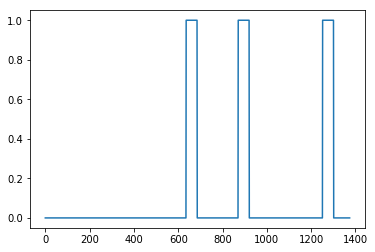

In [4]:
plt.plot(Y[0])

# 2 - Model

Now that you've built a dataset, lets write and train a trigger word detection model! 

The model will use 1-D convolutional layers, GRU layers, and dense layers. Let's load the packages that will allow you to use these layers in Keras. This might take a minute to load. 

In [12]:
from keras.callbacks import ModelCheckpoint
from keras.models import Model, load_model, Sequential
from keras.layers import Dense, Activation, Dropout, Input, Masking, TimeDistributed, LSTM, Conv1D
from keras.layers import GRU, Bidirectional, BatchNormalization, Reshape
from keras.optimizers import Adam

Using TensorFlow backend.


In [13]:
callbacks_list = [ModelCheckpoint(
    filepath='./exported_models/V1_8_full_generator/hola_thalon-{epoch:02d}-{acc:.2f}.h5',
    monitor='acc')
]

## 2.1 - Build the model

Here is the architecture we will use. Take some time to look over the model and see if it makes sense. 

<img src="images/model_trigger.png" style="width:600px;height:600px;">
<center> **Figure 3** </center>

One key step of this model is the 1D convolutional step (near the bottom of Figure 3). It inputs the 5511 step spectrogram, and outputs a 1375 step output, which is then further processed by multiple layers to get the final $T_y = 1375$ step output. This layer plays a role similar to the 2D convolutions you saw in Course 4, of extracting low-level features and then possibly generating an output of a smaller dimension. 

Computationally, the 1-D conv layer also helps speed up the model because now the GRU  has to process only 1375 timesteps rather than 5511 timesteps. The two GRU layers read the sequence of inputs from left to right, then ultimately uses a dense+sigmoid layer to make a prediction for $y^{\langle t \rangle}$. Because $y$ is binary valued (0 or 1), we use a sigmoid output at the last layer to estimate the chance of the output being 1, corresponding to the user having just said "activate."

Note that we use a uni-directional RNN rather than a bi-directional RNN. This is really important for trigger word detection, since we want to be able to detect the trigger word almost immediately after it is said. If we used a bi-directional RNN, we would have to wait for the whole 10sec of audio to be recorded before we could tell if "activate" was said in the first second of the audio clip.  


Implementing the model can be done in four steps:
    
**Step 1**: CONV layer. Use `Conv1D()` to implement this, with 196 filters, 
a filter size of 15 (`kernel_size=15`), and stride of 4. [[See documentation.](https://keras.io/layers/convolutional/#conv1d)]

**Step 2**: First GRU layer. To generate the GRU layer, use:
```
X = GRU(units = 128, return_sequences = True)(X)
```
Setting `return_sequences=True` ensures that all the GRU's hidden states are fed to the next layer. Remember to follow this with Dropout and BatchNorm layers. 

**Step 3**: Second GRU layer. This is similar to the previous GRU layer (remember to use `return_sequences=True`), but has an extra dropout layer. 

**Step 4**: Create a time-distributed dense layer as follows: 
```
X = TimeDistributed(Dense(1, activation = "sigmoid"))(X)
```
This creates a dense layer followed by a sigmoid, so that the parameters used for the dense layer are the same for every time step. [[See documentation](https://keras.io/layers/wrappers/).]

**Exercise**: Implement `model()`, the architecture is presented in Figure 3.

In [14]:
# GRADED FUNCTION: model

def model(input_shape):
    """
    Function creating the model's graph in Keras.
    
    Argument:
    input_shape -- shape of the model's input data (using Keras conventions)

    Returns:
    model -- Keras model instance
    """
    
    X_input = Input(shape = input_shape)
    
    ### START CODE HERE ###
    
    # Step 1: CONV layer (≈4 lines)
    X = Conv1D(196, kernel_size=15, strides=4)(X_input)                                 # CONV1D
    X = BatchNormalization()(X)                                 # Batch normalization
    X = Activation('relu')(X)                                 # ReLu activation
    X = Dropout(0.2)(X)                                 # dropout (use 0.8)

    # Step 2: First GRU Layer (≈4 lines)
    X = GRU(units = 128, return_sequences = True)(X) # GRU (use 128 units and return the sequences)
    X = Dropout(0.2)(X)                                 # dropout (use 0.8)
    X = BatchNormalization()(X)                                 # Batch normalization
    
    # Step 3: Second GRU Layer (≈4 lines)
    X = GRU(units = 128, return_sequences = True)(X)   # GRU (use 128 units and return the sequences)
    X = Dropout(0.2)(X)                                 # dropout (use 0.8)
    X = BatchNormalization()(X)                                  # Batch normalization
    X = Dropout(0.2)(X)                                  # dropout (use 0.8)
    
    # Step 4: Time-distributed dense layer (≈1 line)
    X = TimeDistributed(Dense(1, activation = "sigmoid"))(X) # time distributed  (sigmoid)

    ### END CODE HERE ###

    model = Model(inputs = X_input, outputs = X)
    
    return model  

In [15]:
model = model(input_shape = (Tx, n_freq))

Let's print the model summary to keep track of the shapes.

In [16]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 5511, 101)         0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 1375, 196)         297136    
_________________________________________________________________
batch_normalization_1 (Batch (None, 1375, 196)         784       
_________________________________________________________________
activation_1 (Activation)    (None, 1375, 196)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 1375, 196)         0         
_________________________________________________________________
gru_1 (GRU)                  (None, 1375, 128)         124800    
_________________________________________________________________
dropout_2 (Dropout)          (None, 1375, 128)         0         
__________

**Expected Output**:

<table>
    <tr>
        <td>
            **Total params**
        </td>
        <td>
           522,561
        </td>
    </tr>
    <tr>
        <td>
            **Trainable params**
        </td>
        <td>
           521,657
        </td>
    </tr>
    <tr>
        <td>
            **Non-trainable params**
        </td>
        <td>
           904
        </td>
    </tr>
</table>

The output of the network is of shape (None, 1375, 1) while the input is (None, 5511, 101). The Conv1D has reduced the number of steps from 5511 at spectrogram to 1375. 

## 2.2 - Fit the model

Trigger word detection takes a long time to train. To save time, we've already trained a model for about 3 hours on a GPU using the architecture you built above, and a large training set of about 4000 examples. Let's load the model. 

In [17]:
# model = load_model('./models/tr_model.h5')
model = load_model('./exported_models/V1_7_full_generator/hola_thalon-31-0.98.h5')
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 5511, 101)         0         
_________________________________________________________________
conv1d_3 (Conv1D)            (None, 1375, 256)         388096    
_________________________________________________________________
batch_normalization_7 (Batch (None, 1375, 256)         1024      
_________________________________________________________________
activation_3 (Activation)    (None, 1375, 256)         0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 1375, 256)         0         
_________________________________________________________________
gru_5 (GRU)                  (None, 1375, 128)         147840    
_________________________________________________________________
dropout_8 (Dropout)          (None, 1375, 128)         0         
__________

In [18]:
from keras import backend as K

def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

You can train the model further, using the Adam optimizer and binary cross entropy loss, as follows. This will run quickly because we are training just for one epoch and with a small training set of 26 examples. 

In [18]:
# keras default adam optimizer
# opt = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
opt = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, decay=0.01)

# opt = Adam(lr=0.001, beta_1=0.9, beta_2=0.999, decay=0.01)
# model.compile(loss='binary_crossentropy', optimizer=opt, metrics=["accuracy"])

model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=["accuracy"])
# model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=['acc', f1_m, precision_m, recall_m])

Epoch 1/2
250/250 [==============================] - 943s 4s/step - loss: 0.0602 - acc: 0.9795
Epoch 2/2
250/250 [==============================] - 1905s 8s/step - loss: 0.0599 - acc: 0.9795


'\nfor j in range(40):\n    model.fit_generator(train_gen,\n                        steps_per_epoch=250,\n                        epochs=1,\n                        initial_epoch=0,\n                        callbacks=callbacks_list)\n'

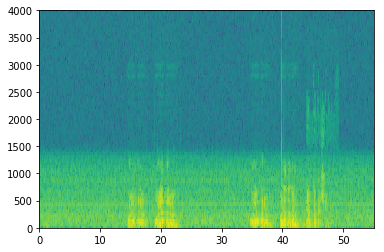

In [19]:
# model.fit(X, Y, batch_size = 5, epochs=1)
# model.fit(X, Y, batch_size = 16, epochs = 40, callbacks=callbacks_list)

model.fit_generator(train_gen,
                    steps_per_epoch=250,
                    epochs=2,
                    max_queue_size=1, 
                    callbacks=callbacks_list)
'''
for j in range(40):
    model.fit_generator(train_gen,
                        steps_per_epoch=250,
                        epochs=1,
                        initial_epoch=0,
                        callbacks=callbacks_list)
'''
#, batch_size = 16, epochs = 40, callbacks=callbacks_list)
# model.fit(X, Y, batch_size = 16, epochs = 10, validation_split = 0.3)

# 3 - Making Predictions

Now that you have built a working model for trigger word detection, let's use it to make predictions. This code snippet runs audio (saved in a wav file) through the network. 

<!--
can use your model to make predictions on new audio clips.

You will first need to compute the predictions for an input audio clip.

**Exercise**: Implement predict_activates(). You will need to do the following:

1. Compute the spectrogram for the audio file
2. Use `np.swap` and `np.expand_dims` to reshape your input to size (1, Tx, n_freqs)
5. Use forward propagation on your model to compute the prediction at each output step
!-->

In [12]:
def detect_triggerword(filename):
    plt.subplot(2, 1, 1)

    x = graph_spectrogram(filename)
    # the spectogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

Once you've estimated the probability of having detected the word "activate" at each output step, you can trigger a "chiming" sound to play when the probability is above a certain threshold. Further, $y^{\langle t \rangle}$ might be near 1 for many values in a row after "activate" is said, yet we want to chime only once. So we will insert a chime sound at most once every 75 output steps. This will help prevent us from inserting two chimes for a single instance of "activate". (This plays a role similar to non-max suppression from computer vision.) 

<!-- 
**Exercise**: Implement chime_on_activate(). You will need to do the following:

1. Loop over the predicted probabilities at each output step
2. When the prediction is larger than the threshold and more than 75 consecutive time steps have passed, insert a "chime" sound onto the original audio clip

Use this code to convert from the 1,375 step discretization to the 10,000 step discretization and insert a "chime" using pydub:

` audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio.duration_seconds)*1000)
`
!--> 

In [13]:
chime_file = "audio_examples/chime.wav"
def chime_on_activate(filename, predictions, threshold):
    audio_clip = AudioSegment.from_wav(filename)
    chime = AudioSegment.from_wav(chime_file)
    Ty = predictions.shape[1]
    # Step 1: Initialize the number of consecutive output steps to 0
    consecutive_timesteps = 0
    # Step 2: Loop over the output steps in the y
    for i in range(Ty):
        # Step 3: Increment consecutive output steps
        consecutive_timesteps += 1
        # Step 4: If prediction is higher than the threshold and more than 75 consecutive output steps have passed
        if predictions[0,i,0] > threshold and consecutive_timesteps > 75:
            # Step 5: Superpose audio and background using pydub
            audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio_clip.duration_seconds)*1000)
            # Step 6: Reset consecutive output steps to 0
            consecutive_timesteps = 0
        
    audio_clip.export("chime_output.wav", format='wav')

## 3.3 - Test on dev examples

Let's explore how our model performs on two unseen audio clips from the development set. Lets first listen to the two dev set clips. 

In [16]:
IPython.display.Audio("./raw_thalon_audios/train_2.wav")

In [17]:
IPython.display.Audio("./raw_thalon_audios/train_9.wav")

Now lets run the model on these audio clips and see if it adds a chime after "activate"!

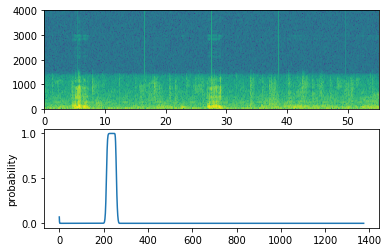

In [94]:
filename = "./audio_test/instant_audio_10sec.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

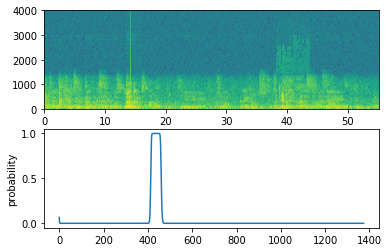

In [89]:
filename  = "./raw_thalon_audios/train_10.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

In [32]:
# model.save('hola_thalon_trigger.h5')

In [59]:
def detect_triggerword2(filename):
    plt.subplot(2, 1, 1)

    x = graph_spectrogram(filename)
    # the spectogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model2.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

In [108]:
from keras.models import load_model
## Seems to work
# model2 = load_model('./exported_models/V1_full/hola_thalon-04-0.98.h5')
#### requires to add extra background
#############
model2 = load_model('./exported_models/V1_6_full/hola_thalon-03-0.95.h5')
# model2.summary()

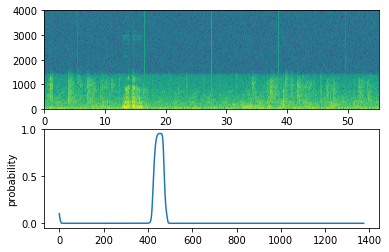

In [109]:
filename  = "./audio_test/instant_audio_10sec.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

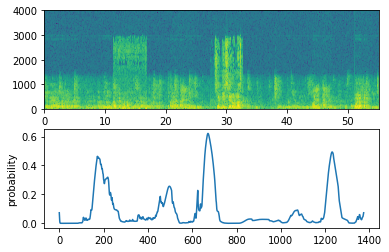

In [20]:
filename  = "./raw_thalon_audios/train_927.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.2)
IPython.display.Audio("./chime_output.wav")

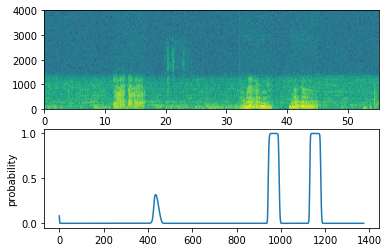

In [26]:
filename  = "./raw_thalon_audios_stereo/train_527.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.2)
IPython.display.Audio("./chime_output.wav")

In [6]:
activates_test, negatives, backgrounds = load_raw_audio_thalon_list_test()
print(len(activates_test), len(negatives), len(backgrounds))

4 7058 8642


In [13]:
def create_testing_example(counter, backgrounds, activates, negatives):
    """
    Creates a training example with a given background, activates, and negatives.
    
    Arguments:
    background -- a 10 second background audio recording
    activates -- a list of audio segments of the word "activate"
    negatives -- a list of audio segments of random words that are not "activate"
    
    Returns:
    x -- the spectrogram of the training example
    y -- the label at each time step of the spectrogram
    """
    
    # Select 0-4 random "activate" audio clips from the entire list of "activates" recordings
    random_activates = load_raw_data(random.sample(activates, k=random.randint(1, 3)))
    print('random_activates', len(random_activates))
    
    # Select 0-2 random negatives audio recordings from the entire list of "negatives" recordings
    random_negatives = [] # load_raw_data(random.sample(negatives, k=random.randint(1, 3)))
    print('random_negatives', len(random_negatives))
    
    background = load_raw_data(random.sample(backgrounds, k=1))
    print('background', len(background))
    
    # Make background quieter
    background = background[0] - 20

    ### START CODE HERE ###
    # Step 1: Initialize y (label vector) of zeros (≈ 1 line)
    y = np.zeros((1, Ty))

    # Step 2: Initialize segment times as empty list (≈ 1 line)
    previous_segments = []
    ### END CODE HERE ###
    
    
    ### START CODE HERE ### (≈ 3 lines)
    # Step 3: Loop over randomly selected "activate" clips and insert in background
    for random_activate in random_activates:
        # Insert the audio clip on the background
        background, segment_time = insert_audio_clip(background, random_activate, previous_segments)
        # Retrieve segment_start and segment_end from segment_time
        segment_start, segment_end = segment_time
        # Insert labels in "y"
        y = insert_ones(y, segment_end_ms=segment_end)
    ### END CODE HERE ###
    
    print('previous_segments_active:', previous_segments)    

    ### START CODE HERE ### (≈ 2 lines)
    # Step 4: Loop over randomly selected negative clips and insert in background
    for random_negative in random_negatives:
        # Insert the audio clip on the background 
        background, _ = insert_audio_clip(background, random_negative, previous_segments)
    ### END CODE HERE ###
    
    # Standardize the volume of the audio clip 
    background = match_target_amplitude(background, -20.0)
    
    print('previous_segments_total:', previous_segments)

    # Export new training example 
    file_handle = background.export("./raw_thalon_audios_test/test_" + str(counter) + ".wav", format="wav")
    print("File (test_" + str(counter) + ".wav) was saved in your directory.")
    
    # Get and plot spectrogram of the new recording (background with superposition of positive and negatives)
    x = graph_spectrogram("./raw_thalon_audios_test/test_" + str(counter) + ".wav")
    
    return x, y

opening ./audio_test/microphone_results_test.wav
opening ./audio_test/microphone_results_test (copy).wav
random_activates 2
random_negatives 0
opening ./database/wav_resampling/backgrounds_10sec/ch06_5_23.wav
background 1
previous_segments_active: [(76, 843), (8598, 9365)]
previous_segments_total: [(76, 843), (8598, 9365)]
File (test_1.wav) was saved in your directory.
opening ./audio_test/microphone_results_test (copy).wav
random_activates 1
random_negatives 0
opening ./database/wav_resampling/backgrounds_10sec/ch14_13_21.wav
background 1
previous_segments_active: [(4111, 4878)]
previous_segments_total: [(4111, 4878)]
File (test_2.wav) was saved in your directory.
opening ./audio_test/microphone_results_test (3rd copy).wav
opening ./audio_test/microphone_results_test.wav
random_activates 2
random_negatives 0
opening ./database/wav_resampling/backgrounds_10sec/ch16_25.wav
background 1
previous_segments_active: [(2789, 3556), (3975, 4742)]
previous_segments_total: [(2789, 3556), (3975, 

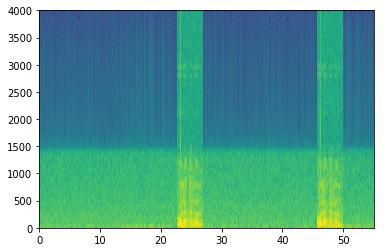

In [25]:
X_data = []
Y_data = []
num_data = 10

# cnt_data = 0
# while True:
for cnt_data in range(1, num_data + 1):
    x, y = create_testing_example(cnt_data, backgrounds, activates_test, negatives)
    X_data.append(x.transpose())
    Y_data.append(y.transpose())
    
    if cnt_data == num_data:
        np.save('./XY_thalon_test/X_thalon.npy', X_data)
        np.save('./XY_thalon_test/Y_thalon.npy', Y_data)
        print('************************* Saving data at {} iteration **********************'.format(cnt_data))
    '''
    if cnt_data % 1000 == 0:
        x = input('Enter your input (x to exit):')
        if x == 'x':
            break
    
    cnt_data += 1
    '''

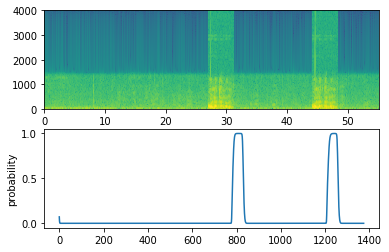

In [35]:
filename  = "./raw_thalon_audios_test/test_5.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.1)
IPython.display.Audio("./chime_output.wav")

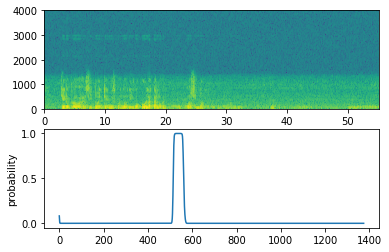

In [28]:
filename  = "./audio_examples/thalon/test_audio_1_mod.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.8)
IPython.display.Audio("./chime_output.wav")

In [47]:
filename = "./audio_examples/thalon/output_2_10sec.wav"
audio_clip = AudioSegment.from_wav(filename)
audio_clip.export('./audio_examples/thalon/output_2_10sec_amp.wav', format="wav")

<_io.BufferedRandom name='./audio_examples/thalon/output_2_10sec_amp.wav'>

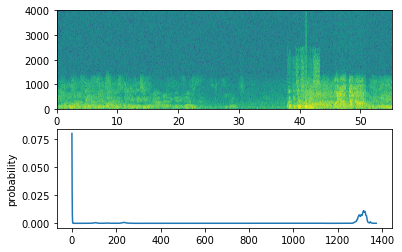

In [59]:
filename2 = "./audio_examples/thalon/output_2_10sec.wav"
filename2 = "./raw_thalon_audios_stereo/train_997.wav"
prediction = detect_triggerword2(filename2)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")